In [1]:
import os
import numpy as np
import pandas as pd
import seaborn as sns

In [2]:
plt.rcParams['figure.dpi'] = 300
sns.set_context('talk', font_scale= 1.2)

# Figure 4A

In [3]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20200508_maternal500_fetal_wo_outliers.csv')
adata_df = pd.read_csv(umap_path)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (42) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [4]:
clean_df = adata_df[(adata_df['test_status'] == 'test') & 
                    adata_df['organ'].isin(['PB', 'PL_F', 'PL_M'])]
bl_df = clean_df[(clean_df['challenge'] == 'sal') & (clean_df['timePI'] == '2hr') & (clean_df['origin'] == 'maternal')]

In [5]:
bl_df.columns

Index(['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD194', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86',
       'prpS6', 'day', 'organ', 'id', 'cage', 'timePI', 'challenge', 'origin',
       'location', 'leiden1', 'PD-L1_status', 'PD-1_status', 'CTLA-4_status',
       'CD64_status', 'CD62L_status', 'CD25_status', 'CD194_status',
       'CD69_status', 'CD80_status', 'CD86_status', 'B220_status',
       'CD40_status', 'CD44_status', 'IdU_status', 'cell_descript',
       'test_status', 'sample', 'cell_type', 'compartment', 'umap1', 'umap2',
       'cell_type_v2', 'compartment2'],
      dtype='object')

In [6]:
leiden_color_dictv2 = {'B cells': '#355C7D',
 'CD4+ T cells': '#F8B195',
 'CD8+ T cells': '#F67280',
 'Eosinophils': '#A30059',
 'Basophils': '#b4b4ee',
 'Monocytes': '#6C5B7B',
 'NK cells': '#b4d1ee',
 'Neutrophils': '#999097'}

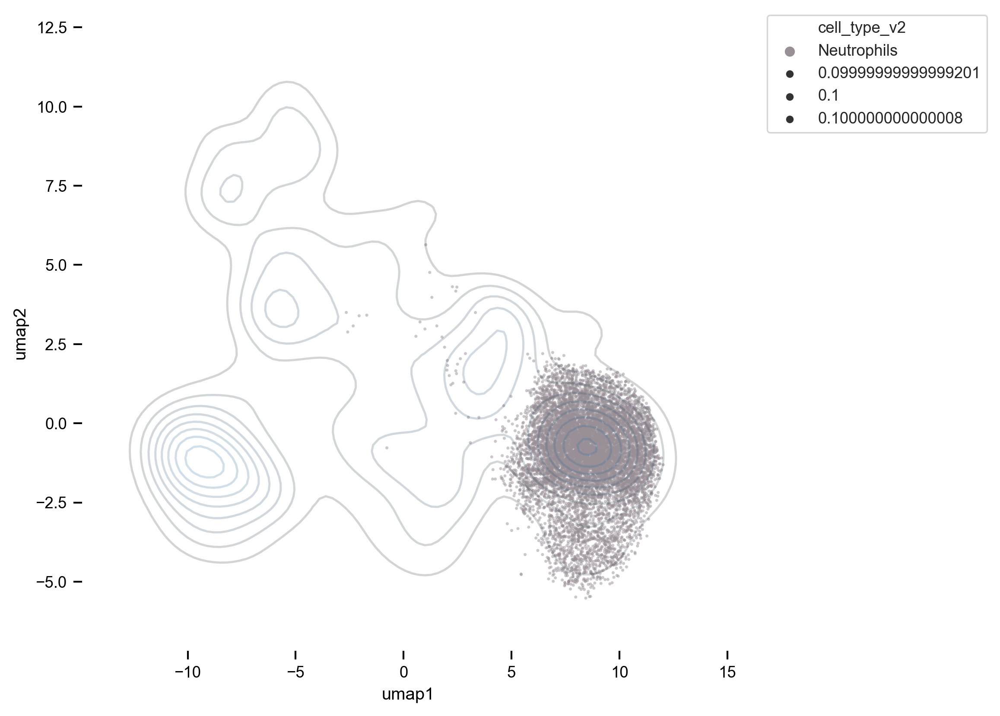

In [7]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = bl_df['umap1'], data2= bl_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)

sns.scatterplot(data = bl_df[bl_df['cell_type_v2']=='Neutrophils'], 
                hue = 'cell_type_v2', palette = leiden_color_dictv2, x='umap1', y='umap2', marker='.', size = 0.1, 
                linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Neutrophil characterization and subsets

In [10]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
adata_path = os.path.join(subsample_path, 'maternal500_fetal_wo_outliers.h5ad')
adata = sc.read_h5ad(adata_path)

In [14]:
adata.obs['sample'] = adata.obs['cage'].astype(str).str.cat(adata.obs['id'].astype(str), sep= '_')
adata.obs['sample'] = adata.obs['sample'].str.cat(adata.obs['day'], sep= '_')
adata.obs['sample'] = adata.obs['sample'].str.cat(adata.obs['challenge'], sep= '_')
adata.obs['sample'] = adata.obs['sample'].str.cat(adata.obs['timePI'], sep= '_')
adata.obs['sample'] = adata.obs['sample'].str.cat(adata.obs['compartment2'], sep= '_')

In [30]:
adata.obs.head(5)

,day,organ,id,cage,timePI,challenge,origin,location,leiden1,PD-L1_status,...,IdU_status,cell_descript,test_status,sample,cell_type,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2
index,,,,,,,,,,,,,,,,,,,,,
0,E12.5,PB,15,3576,24hr,sal,maternal,EV,B cells CD11b-,PD-L1-,...,IdU-,B cells CD11b-_E12.5_sal_24hr_3576_15_PB_EV,test,3576_15_E12.5_sal_24hr_PB-EV,B cells IgMneg,PB-EV,14,B_cells,B cells,PB-EV
2,E12.5,PB,15,3576,24hr,sal,maternal,EV,B cells CD11b-,PD-L1-,...,IdU-,B cells CD11b-_E12.5_sal_24hr_3576_15_PB_EV,test,3576_15_E12.5_sal_24hr_PB-EV,B cells IgMneg,PB-EV,14,B_cells,B cells,PB-EV
4,E12.5,PB,15,3576,24hr,sal,maternal,EV,B cells CD11b-,PD-L1-,...,IdU-,B cells CD11b-_E12.5_sal_24hr_3576_15_PB_EV,test,3576_15_E12.5_sal_24hr_PB-EV,B cells IgMneg,PB-EV,1,B_cells,B cells,PB-EV
5,E12.5,PB,15,3576,24hr,sal,maternal,EV,B cells CD11b-,PD-L1-,...,IdU-,B cells CD11b-_E12.5_sal_24hr_3576_15_PB_EV,test,3576_15_E12.5_sal_24hr_PB-EV,B cells IgMneg,PB-EV,14,B_cells,B cells,PB-EV
6,E12.5,PB,15,3576,24hr,sal,maternal,EV,B cells CD11b-,PD-L1-,...,IdU-,B cells CD11b-_E12.5_sal_24hr_3576_15_PB_EV,test,3576_15_E12.5_sal_24hr_PB-EV,B cells IgMneg,PB-EV,14,B_cells,B cells,PB-EV


In [15]:
adata.obs['sample'].head(5)

index
0    3576_15_E12.5_sal_24hr_PB-EV
2    3576_15_E12.5_sal_24hr_PB-EV
4    3576_15_E12.5_sal_24hr_PB-EV
5    3576_15_E12.5_sal_24hr_PB-EV
6    3576_15_E12.5_sal_24hr_PB-EV
Name: sample, dtype: object

In [16]:
samples_whole_PL = ['748_5_E12.5_sal_24hr_PL-T',
                    '438_4_E14.5_sal_24hr_PL-T',
                    '439_6_E14.5_sal_24hr_PL-T',
                    '2991_5_E14.5_sal_24hr_PL-T',
                    '3574_2_E12.5_lps_24hr_PL-T',
                    '3574_1_E12.5_sal_24hr_PL-T',
                    '3574_1_E12.5_sal_24hr_PL-EV',
                    '3576_15_E12.5_sal_24hr_PL-T',
                    '3576_15_E12.5_sal_24hr_PL-EV']

In [20]:
categories = np.array(['PB-EV','PL-EV', 'PL-T', 'PL-whole'])
adata.obs['compartment2'] = pd.Categorical(adata.obs['compartment2'], categories=categories, ordered=True)

In [21]:
PL_mask = (adata.obs['sample'].isin(samples_whole_PL))
adata.obs['compartment2'][PL_mask] = 'PL-whole'

In [25]:
adata.write(adata_path)

... storing 'sample' as categorical


In [14]:
neu_adata = adata[adata.obs['cell_type_v2'].isin(['Neutrophils'])&
                            adata.obs['compartment2'].isin(['PB-EV','PL-EV', 'PL-T', 'PL-whole'])&
                           (adata.obs['origin'] == 'maternal')]

In [32]:
neu_adata.obs.head(5)

,day,organ,id,cage,timePI,challenge,origin,location,leiden1,PD-L1_status,...,IdU_status,cell_descript,test_status,sample,cell_type,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2
index,,,,,,,,,,,,,,,,,,,,,
16,E12.5,PB,15,3576,24hr,sal,maternal,EV,Neutrophils CD11bhi,PD-L1-,...,IdU-,Neutrophils CD11bhi_E12.5_sal_24hr_3576_15_PB_EV,test,3576_15_E12.5_sal_24hr_PB-EV,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV
46,E12.5,PB,15,3576,24hr,sal,maternal,EV,Neutrophils CD11bhi,PD-L1-,...,IdU-,Neutrophils CD11bhi_E12.5_sal_24hr_3576_15_PB_EV,test,3576_15_E12.5_sal_24hr_PB-EV,Neutrophils Ly6Ghi,PB-EV,10,B_cells,Neutrophils,PB-EV
190,E12.5,PB,15,3576,24hr,sal,maternal,EV,Neutrophils CD11bhi,PD-L1-,...,IdU-,Neutrophils CD11bhi_E12.5_sal_24hr_3576_15_PB_EV,test,3576_15_E12.5_sal_24hr_PB-EV,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV
240,E12.5,PB,15,3576,24hr,sal,maternal,EV,Neutrophils CD11bmid,PD-L1-,...,IdU-,Neutrophils CD11bmid_E12.5_sal_24hr_3576_15_PB_EV,test,3576_15_E12.5_sal_24hr_PB-EV,Neutrophils Ly6Gmid,PB-EV,8,Neu,Neutrophils,PB-EV
68-1,E12.5,PB,1,3574,24hr,sal,maternal,EV,Neutrophils CD11bhi,PD-L1-,...,IdU-,Neutrophils CD11bhi_E12.5_sal_24hr_3574_1_PB_EV,test,3574_1_E12.5_sal_24hr_PB-EV,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV


In [15]:
neu_adata.obs['neu_CD11b'] = 'mid'
CD11b_mask_all = (neu_adata[:, 'CD11b'].X >= 6.5)
neu_adata.obs['neu_CD11b'][CD11b_mask_all] = 'high'

Trying to set attribute `.obs` of view, making a copy.
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


... storing 'neu_CD11b' as categorical


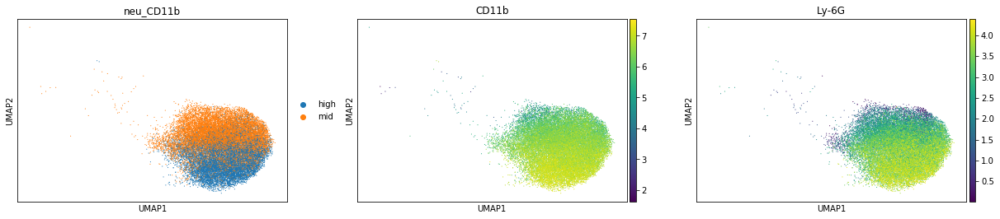

In [16]:
sc.pl.umap(neu_adata, color = ['neu_CD11b', 'CD11b','Ly-6G'], use_raw = False)

In [11]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
neu_adata_path = os.path.join(subsample_path, '20201116_Neu_maternal500wo_outliers.h5ad')
neu_adata= sc.read_h5ad(neu_adata_path)

In [37]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
neu_adata_path = os.path.join(subsample_path, '20201116_Neu_maternal500wo_outliers.h5ad')
neu_adata.write(neu_adata_path)

... storing 'neu_CD11b' as categorical


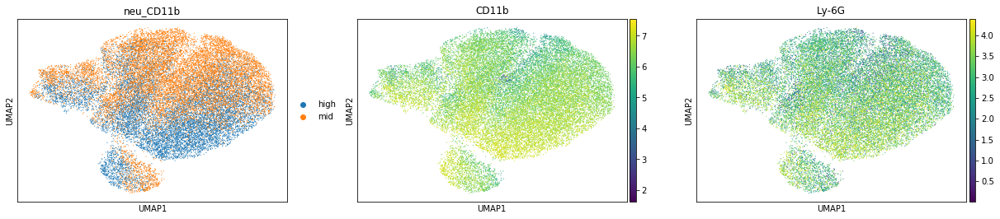

In [13]:
sc.pl.umap(neu_adata, color = ['neu_CD11b', 'CD11b','Ly-6G'], use_raw = False)

# Neutrophil clustering

In [15]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
neu_adata_path = os.path.join(subsample_path, '20201116_Neu_maternal500wo_outliers.h5ad')
neu_adata = sc.read_h5ad(neu_adata_path)

In [16]:
clustering4 =  ['CD62L', 'IdU', 'MHCII', 'CD80', 'CD40', 'PD-L1']

In [17]:
neu_adata.obsm['cluster_channels'] = neu_adata[:, clustering4].X
sc.pp.neighbors(neu_adata, n_neighbors = 20, use_rep= 'cluster_channels', random_state = 1)
sc.tl.umap(neu_adata, random_state = 1)
sc.tl.leiden(neu_adata, resolution=0.5, key_added = 'Neu_leidenv2', random_state = 1)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/anndata/core/anndata.py:846: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


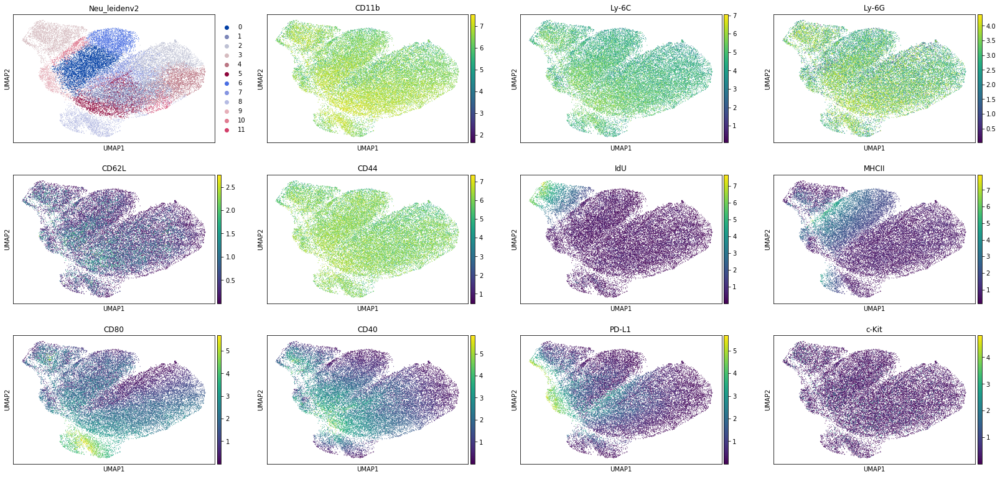

In [18]:
sc.pl.umap(neu_adata, color = ['Neu_leidenv2', 'CD11b','Ly-6C', 'Ly-6G', 'CD62L', 'CD44', 'IdU', 'MHCII', 'CD80', 'CD40', 'PD-L1', 'c-Kit'], use_raw = False)

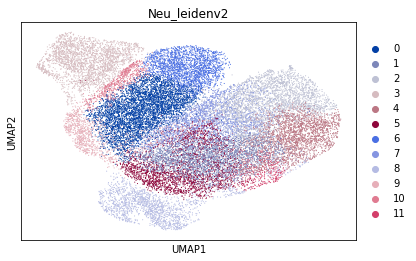

In [19]:
sc.pl.umap(neu_adata, color = ['Neu_leidenv2'], use_raw = False)

In [20]:
neu_adata.write(neu_adata_path)

In [21]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
neu_adata_path = os.path.join(subsample_path, '20201116_Neu_maternal500wo_outliers.h5ad')
neu_adata = sc.read_h5ad(neu_adata_path)

In [22]:
umap_pd = pd.DataFrame(data = neu_adata.obsm['X_umap'], columns = ['umap1', 'umap2']).set_index(neu_adata.obs_names)
adata_df = pd.DataFrame(data = neu_adata.X, columns = neu_adata.var_names).set_index(neu_adata.obs_names)
adata_df = pd.concat([adata_df, neu_adata.obs, umap_pd], axis = 1, join = 'outer', copy = False)
adata_df.rename(columns = {'Neu_leidenv2': 'Neu_leiden2'}, inplace = True)

In [23]:
adata_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,cell_type,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2,neu_CD11b,Neu_leiden2,umap1,umap2
index,,,,,,,,,,,,,,,,,,,,,
16,3.733698,3.482318,0.025405,0.000362,3.540359,2.862674,1.361506,1.185081,0.864763,0.312589,...,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,mid,10,-3.580076,3.440799
46,5.030386,3.235032,0.000000,0.156082,3.322356,1.621257,2.450964,0.995553,0.636060,0.502439,...,Neutrophils Ly6Ghi,PB-EV,10,B_cells,Neutrophils,PB-EV,mid,10,-4.999738,2.305276
190,3.762684,4.037537,0.113570,0.000362,3.977293,2.253136,2.469895,2.150812,0.965666,0.292154,...,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,mid,8,-5.261172,-6.809465
240,2.139523,3.691419,0.052421,0.000362,1.301516,0.089487,0.008133,0.087274,0.224940,0.002609,...,Neutrophils Ly6Gmid,PB-EV,8,Neu,Neutrophils,PB-EV,mid,0,-3.039389,1.380814
68-1,3.356221,1.707314,0.100837,0.000362,3.977293,1.615526,2.796888,0.087274,0.951465,0.269706,...,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,mid,10,-4.738510,2.784621


In [24]:
Neu_name_dict = {'8': 'CD80pos',
                 '3': 'proliferating',
                 '0': 'act_presenting',
                 '10': 'act_presenting',
                 '6': 'presenting',
                 '9': 'immunosupressive',
                 '2': 'conventional',
                 '4': 'conventional',
                 '7': 'act_conventional',
                 '1': 'act_conventional',
                 '5': 'act_conventional',
                 '11': 'act_conventional'}
adata_df.loc[:,'neu_type'] = adata_df['Neu_leiden2'].map(Neu_name_dict)

In [25]:
adata_df['neu_type'].unique()

array(['act_presenting', 'CD80pos', 'immunosupressive',
       'act_conventional', 'presenting', 'conventional', 'proliferating'],
      dtype=object)

In [26]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20201120_Neu_bl_maternal500wo_outliers.csv')
adata_df.to_csv(umap_path, index = False)

In [254]:
adata_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2,neu_CD11b,Neu_leiden2,umap1,umap2,neu_type
index,,,,,,,,,,,,,,,,,,,,,
16,3.733698,3.482318,0.025405,0.000362,3.540359,2.862674,1.361506,1.185081,0.864763,0.312589,...,PB-EV,2,Neu,Neutrophils,PB-EV,mid,10,-3.580076,3.440799,act_presenting
46,5.030386,3.235032,0.000000,0.156082,3.322356,1.621257,2.450964,0.995553,0.636060,0.502439,...,PB-EV,10,B_cells,Neutrophils,PB-EV,mid,10,-4.999738,2.305276,act_presenting
190,3.762684,4.037537,0.113570,0.000362,3.977293,2.253136,2.469895,2.150812,0.965666,0.292154,...,PB-EV,2,Neu,Neutrophils,PB-EV,mid,8,-5.261172,-6.809465,CD80pos
240,2.139523,3.691419,0.052421,0.000362,1.301516,0.089487,0.008133,0.087274,0.224940,0.002609,...,PB-EV,8,Neu,Neutrophils,PB-EV,mid,0,-3.039389,1.380814,act_presenting
68-1,3.356221,1.707314,0.100837,0.000362,3.977293,1.615526,2.796888,0.087274,0.951465,0.269706,...,PB-EV,2,Neu,Neutrophils,PB-EV,mid,10,-4.738510,2.784621,act_presenting


# Neu correlations with CD11b

In [356]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20201120_Neu_bl_maternal500wo_outliers.csv')
adata_df= pd.read_csv(umap_path)
adata_df.loc[:,['cage', 'id', 'Neu_leiden2']] = adata_df.loc[:,['cage', 'id', 'Neu_leiden2']].astype(str)

In [359]:
adata_df['timePI'].unique()

array(['24hr', '2hr'], dtype=object)

In [380]:
neu_df = adata_df[(adata_df['challenge']=='sal') & 
                     (adata_df['day'] == 'E12.5') & 
                     (adata_df['timePI'] == '2hr') &
                     (adata_df['compartment2'] == 'PB-EV')]

In [362]:
int_cols = ['CD62L', 'CD80', 'CD44', 'CD40', 'CD11b', 'neu_type']

In [367]:
Neu_leiden2_dict = {'act_conventional': '#F8B195',
'presenting': '#FC9134',
#'Ly6Glow': '#C06C84',                                       
'conventional':'#A8E6CE',
'act_presenting':'#6C5B7B',
'proliferating': '#FE4365',
'CD80pos': '#A8A7A7',
'immunosupressive': '#2F9599'}

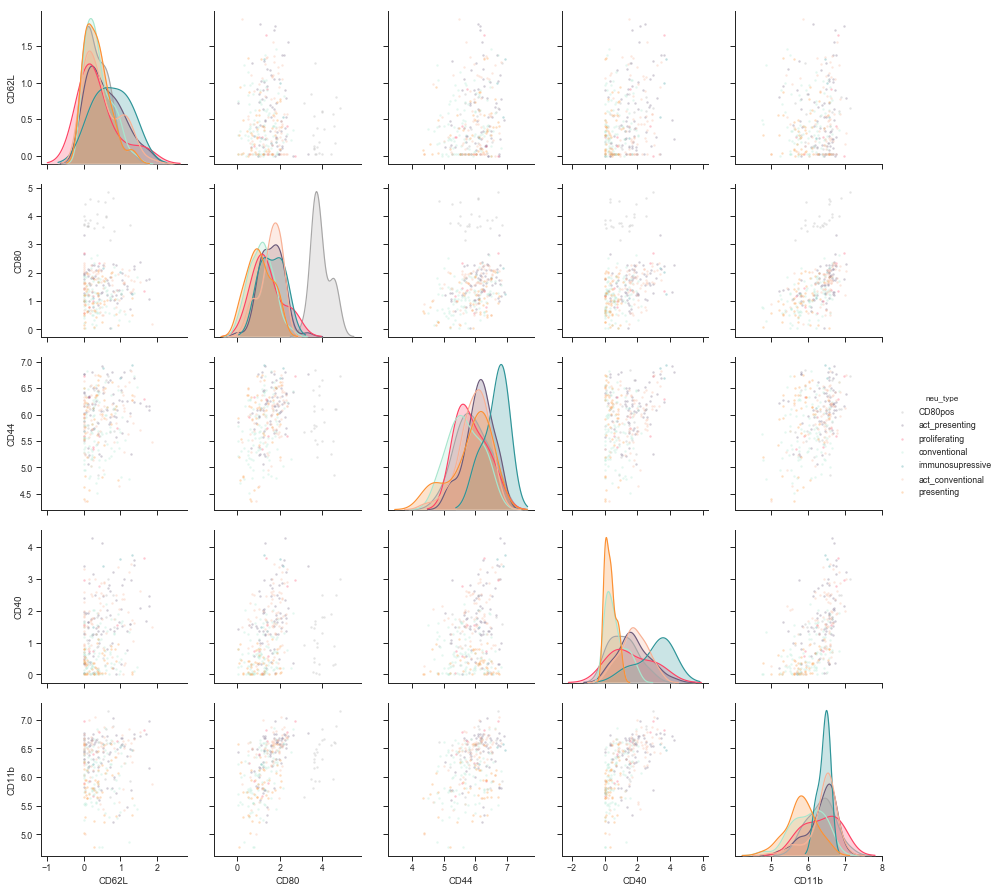

In [381]:
sns.pairplot(neu_df.loc[:,int_cols],  hue = 'neu_type', palette = Neu_leiden2_dict,markers='.', 
             plot_kws = {'alpha' : 0.3,'linewidth': 0 })

# Neu medians

In [255]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20201120_Neu_bl_maternal500wo_outliers.csv')
adata_df= pd.read_csv(umap_path)
adata_df.loc[:,['cage', 'id', 'Neu_leiden2']] = adata_df.loc[:,['cage', 'id', 'Neu_leiden2']].astype(str)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (42) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [325]:
adata_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2,neu_CD11b,Neu_leiden2,umap1,umap2,neu_type
0,3.733698,3.482318,0.025405,0.000362,3.540359,2.862674,1.361506,1.185080,0.864763,0.312589,...,PB-EV,2,Neu,Neutrophils,PB-EV,mid,10,-3.580076,3.440799,act_presenting
1,5.030386,3.235032,0.000000,0.156082,3.322356,1.621257,2.450964,0.995553,0.636060,0.502439,...,PB-EV,10,B_cells,Neutrophils,PB-EV,mid,10,-4.999738,2.305276,act_presenting
2,3.762684,4.037537,0.113570,0.000362,3.977293,2.253136,2.469895,2.150812,0.965666,0.292154,...,PB-EV,2,Neu,Neutrophils,PB-EV,mid,8,-5.261172,-6.809465,CD80pos
3,2.139523,3.691419,0.052421,0.000362,1.301516,0.089487,0.008133,0.087274,0.224940,0.002609,...,PB-EV,8,Neu,Neutrophils,PB-EV,mid,0,-3.039389,1.380814,act_presenting
4,3.356221,1.707313,0.100837,0.000362,3.977293,1.615526,2.796888,0.087274,0.951465,0.269706,...,PB-EV,2,Neu,Neutrophils,PB-EV,mid,10,-4.738510,2.784621,act_presenting


In [327]:
neu_columns_int = ['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86', 
             'timePI',  'cage','challenge', 'day', 'id', 'neu_type', 'neu_CD11b','compartment2']



neu_clean_df = neu_df[(neu_df['test_status'] == 'test') & neu_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T'])]
pivot_series = neu_clean_df[neu_columns_int].pivot_table(columns= ['compartment2','challenge', 'cage','id', 'day', 'timePI'], aggfunc = 'median')
neu_full_median_df = pd.DataFrame(pivot_series)
neu_full_median_df.reset_index(inplace = True)
neu_full_median_df.rename(columns = {'level_0': 'marker', 0: 'median'}, inplace = True)

In [328]:
pivot_series = neu_clean_df[neu_columns_int].pivot_table(columns= ['neu_type', 'compartment2','challenge', 'cage','id', 'day', 'timePI'], aggfunc = 'median')
neu_sub_median_df = pd.DataFrame(pivot_series)
neu_sub_median_df.reset_index(inplace = True)
neu_sub_median_df.rename(columns = {'level_0': 'marker', 0: 'median'}, inplace = True)

In [329]:
pivot_series = neu_clean_df[neu_columns_int].pivot_table(columns= ['neu_type', 'neu_CD11b','compartment2','challenge', 'cage','id', 'day', 'timePI'], aggfunc = 'median')
neu_CD11b_median_df = pd.DataFrame(pivot_series)
neu_CD11b_median_df.reset_index(inplace = True)
neu_CD11b_median_df.rename(columns = {'level_0': 'marker', 0: 'median'}, inplace = True)

In [382]:
df = neu_sub_median_df #neu_full_median_df 

In [383]:
median_df = df[df['challenge'].isin(['sal', 'polyic']) & (df['day'] == 'E12.5') & (df['timePI'] == '2hr')]

In [348]:
challenge_dict = {'sal': '#4295f5', 'polyic': '#f0a10e', 'lps': '#f0a10e'}
challenge_dict2 = {'sal':'Blues','polyic': 'YlOrBr', 'lps': 'Greens'}

In [341]:
median_df.head(5)

,marker,compartment2,challenge,cage,id,day,timePI,median
19,CD45-retroorbital,PB-EV,polyic,2848,7,E12.5,2hr,3.441888
21,CD45-retroorbital,PB-EV,polyic,8238,2,E12.5,2hr,3.936394
22,CD45-retroorbital,PB-EV,polyic,8239,9,E12.5,2hr,3.861619
24,CD45-retroorbital,PB-EV,polyic,8241,19,E12.5,2hr,3.941453
81,CD45-retroorbital,PL-EV,polyic,2848,7,E12.5,2hr,3.651184


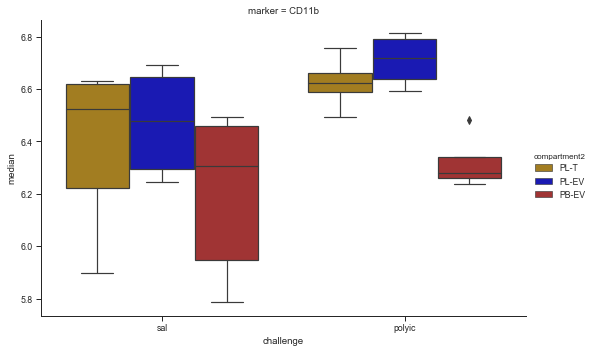

In [345]:
sns.set_style("ticks")
sns.catplot(x = 'challenge', order = ['sal', 'polyic'], y = 'median', kind = 'box', hue_order = ['PL-T', 'PL-EV', 'PB-EV'], sharey = False, col = 'marker',
            hue = 'compartment2', palette = {'PB-EV':'firebrick', 'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod'}, 
            ci = 68, 
            data=median_df[median_df['marker'].isin(['CD11b'])],
            legend_out = True, aspect = 1.5, height = 5)

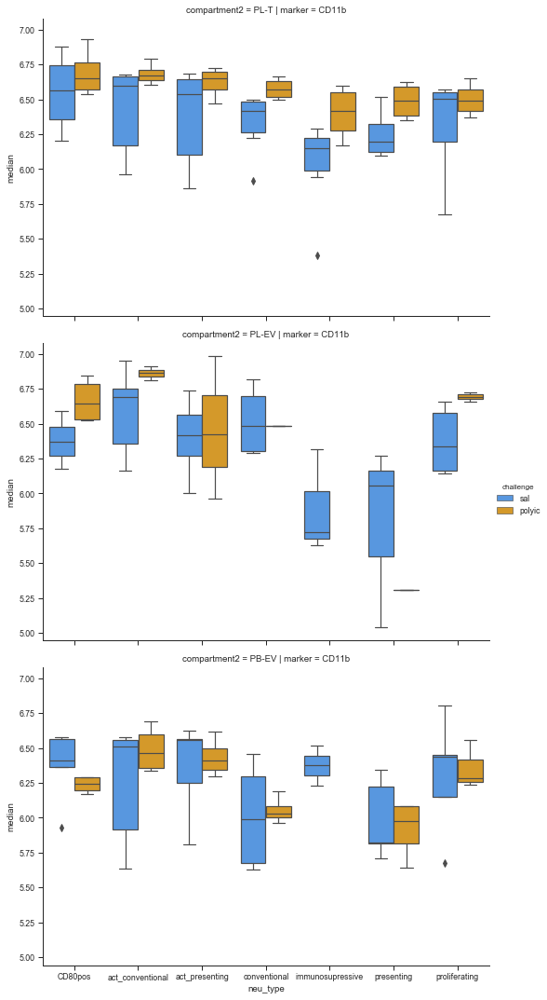

In [352]:
sns.set_style("ticks")
sns.catplot(x = 'neu_type', y = 'median', kind = 'box', 
            row = 'compartment2', row_order = ['PL-T', 'PL-EV', 'PB-EV'], 
            sharey = True, col = 'marker',
            hue = 'challenge', hue_order = ['sal', 'polyic'], palette = challenge_dict, 
            ci = 68, 
            data=median_df[median_df['marker'].isin(['CD11b'])],
            legend_out = True, aspect = 1.5, height = 5)

In [353]:
comp_dict = {'PB-EV':'firebrick', 'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod'}

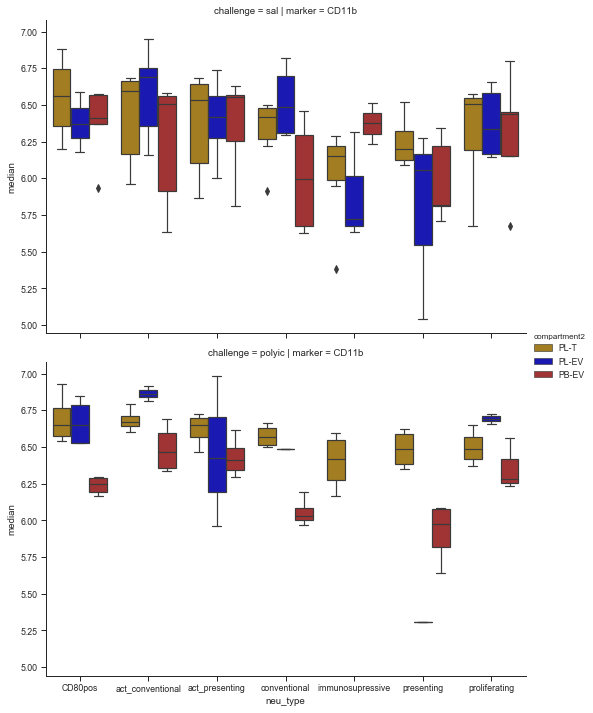

In [354]:
sns.set_style("ticks")
sns.catplot(x = 'neu_type', y = 'median', kind = 'box', 
            row = 'challenge', row_order = ['sal', 'polyic'], 
            sharey = True, col = 'marker',
            hue = 'compartment2', hue_order = ['PL-T', 'PL-EV', 'PB-EV'], palette = comp_dict, 
            ci = 68, 
            data=median_df[median_df['marker'].isin(['CD11b'])],
            legend_out = True, aspect = 1.5, height = 5)

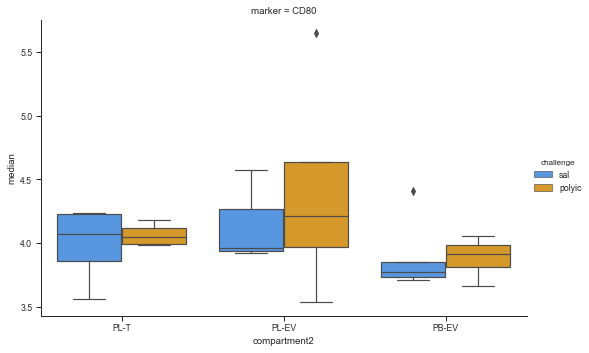

In [388]:
sns.set_style("ticks")
sns.catplot(x = 'compartment2', y = 'median', kind = 'box', 
            order = ['PL-T', 'PL-EV', 'PB-EV'], 
            sharey = True, col = 'marker',
            hue = 'challenge', hue_order = ['sal', 'polyic'], palette = challenge_dict, 
            ci = 68, 
            data=median_df[median_df['marker'].isin(['CD80']) & median_df['neu_type'].isin(['CD80pos'])],
            legend_out = True, aspect = 1.5, height = 5)

In [159]:
neu_bl_df = adata_df[(adata_df['timePI'] == '2hr')& adata_df['compartment2'].isin(['PB-EV', 'PL-T', 'PL-EV'])]

In [160]:
Neu_leiden2_dict = {'act_conventional': '#F8B195',
'presenting': '#FC9134',
#'Ly6Glow': '#C06C84',                                       
'conventional':'#A8E6CE',
'act_presenting':'#6C5B7B',
'proliferating': '#FE4365',
'CD80pos': '#A8A7A7',
'immunosupressive': '#2F9599'}

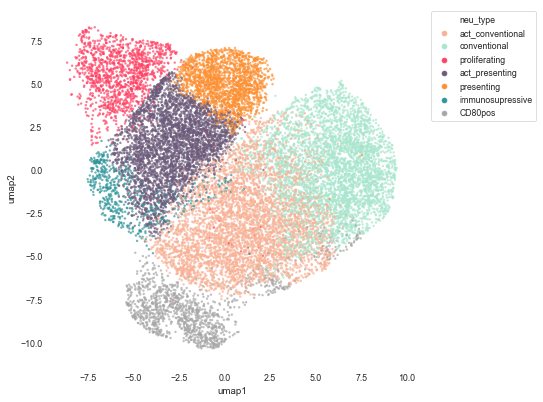

In [161]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.scatterplot(x='umap1', y='umap2', 
                data = neu_bl_df, 
                hue = 'neu_type',
                palette = Neu_leiden2_dict, 
                marker='.', linewidth = 0, alpha = 0.7)
sns.set_style("whitegrid", {'axes.grid' : False})
sns.despine(f, left=True, bottom=True)
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

In [162]:
neu_class_dict = {'high': '#2c2145',
                   'mid': '#babdc2'}

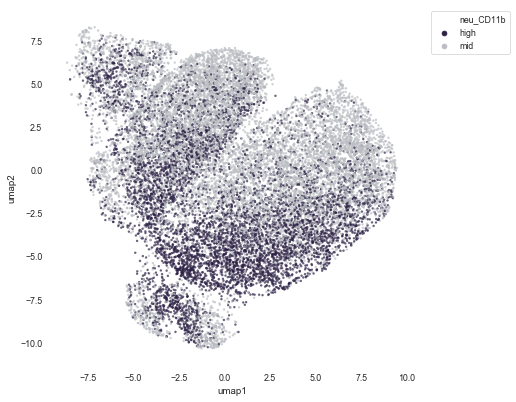

In [163]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.scatterplot(x='umap1', y='umap2', 
                data = neu_bl_df, 
                hue = 'neu_CD11b',
                palette = neu_class_dict, 
                marker='.', linewidth = 0, alpha = 0.7)
sns.set_style("whitegrid", {'axes.grid' : False})
sns.despine(f, left=True, bottom=True)
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

In [2]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20201120_Neu_bl_maternal500wo_outliers.csv')
adata_df= pd.read_csv(umap_path)
adata_df.loc[:,['cage', 'id', 'Neu_leiden2']] = adata_df.loc[:,['cage', 'id', 'Neu_leiden2']].astype(str)
neu_bl_df = adata_df[(adata_df['timePI'] == '2hr')& adata_df['compartment2'].isin(['PB-EV', 'PL-T', 'PL-EV'])]

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (42) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [3]:
class_cell_counts = pd.DataFrame(data = neu_bl_df.groupby(['neu_type','neu_CD11b', 'challenge','compartment2','day','timePI','cage','id']).apply(len))
class_cell_counts.reset_index(inplace = True)
class_cell_counts.rename(columns = {0: 'counts'}, inplace = True)
class_cell_counts['sample'] = class_cell_counts['neu_type'].astype(str).str.cat(class_cell_counts['challenge'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['compartment2'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['day'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['timePI'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['cage'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['id'], sep= '_')

sample_total = pd.DataFrame(data = class_cell_counts.groupby(['sample']).sum())
sample_dict = sample_total.to_dict()
class_cell_counts.loc[:,'sample_total'] = class_cell_counts['sample'].map(sample_dict['counts'])
class_cell_counts['frac_of_comp_sample'] = class_cell_counts['counts']/class_cell_counts['sample_total'] 

In [4]:
class_cell_counts['day'].unique()

array(['E12.5', 'E14.5', 'E10.5', 'E13.5', 'E15.5', 'E16.5', 'E17.5',
       'E18.5', 'E11.5'], dtype=object)

In [5]:
neu_df = class_cell_counts[(class_cell_counts['timePI'] == '2hr')& 
                           (class_cell_counts['day'] == 'E12.5') &
                           (class_cell_counts['challenge'] == 'polyic') & 
                           (class_cell_counts['compartment2'] =='PL-T')]

bl_counts_piv = neu_df.pivot_table(index = ['neu_type', 'challenge','timePI','cage','id'], columns = 'neu_CD11b', values = 'frac_of_comp_sample')
bl_counts_piv.columns = pd.Index(list(bl_counts_piv.columns))
bl_counts_piv.reset_index(inplace = True)
bl_counts_piv.loc[:,'high': 'mid'] = bl_counts_piv.loc[:,'high': 'mid'].fillna(0)
bl_counts_piv.loc[:, 'id':'cage'] = bl_counts_piv.loc[:, 'id':'cage'].astype('str')
composite = bl_counts_piv.groupby(['neu_type']).agg(['mean', 'sem'])
mean_sem_comp = composite.reorder_levels([1, 0], axis = 1)
composite_T = mean_sem_comp['mean'].transpose()
composite_T.reset_index(inplace = True)
composite_T.sum(axis = 0)

neu_type
index               highmid
CD80pos                   1
act_conventional          1
act_presenting            1
conventional              1
immunosupressive          1
presenting                1
proliferating             1
dtype: object

In [6]:
composite_T

neu_type,index,CD80pos,act_conventional,act_presenting,conventional,immunosupressive,presenting,proliferating
0,high,0.736286,0.701092,0.64196,0.641723,0.456344,0.440158,0.524934
1,mid,0.263714,0.298908,0.35804,0.358277,0.543656,0.559842,0.475066


In [8]:
bars_dict

{0: neu_type
 CD80pos             0.736286
 act_conventional    0.701092
 act_presenting       0.64196
 conventional        0.641723
 immunosupressive    0.456344
 presenting          0.440158
 proliferating       0.524934
 Name: 0, dtype: object, 1: neu_type
 CD80pos             0.263714
 act_conventional    0.298908
 act_presenting       0.35804
 conventional        0.358277
 immunosupressive    0.543656
 presenting          0.559842
 proliferating       0.475066
 Name: 1, dtype: object}

In [9]:
composite_T.index

RangeIndex(start=0, stop=2, step=1)

In [7]:
int_to_mo_class = composite_T[['index']].to_dict()
bars_dict = {}
for mo_class in composite_T.index:
    bars_dict[mo_class] = composite_T.iloc[mo_class, 1:]
height_dict = {}
for mo_class in composite_T.index:
    height_dict[mo_class] = composite_T.iloc[mo_class+1:,1:].sum().tolist()

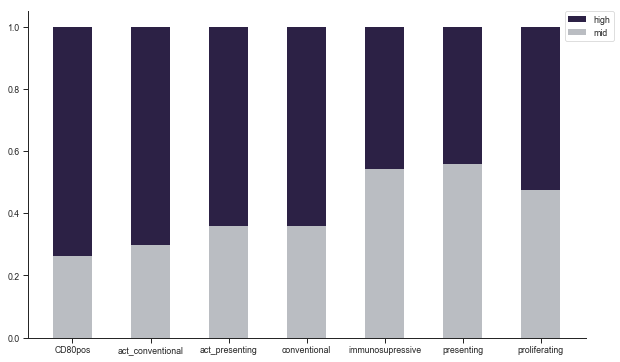

In [189]:
sns.set_style("ticks")
plt.figure(figsize=(10,6)) 
# The position of the bars on the x-axis
r = [0, 0.2, 0.4, 0.6, 0.8, 1.0, 1.2]
 
# Names of group and bar width
names = ['CD80pos',              
 'act_conventional',
 'act_presenting',
 'conventional',
 'immunosupressive',
 'presenting',
 'proliferating']

barWidth = 0.10

for mo_class in composite_T.index:
    plt.bar(r, bars_dict[mo_class], color = neu_class_dict[int_to_mo_class['index'][mo_class]], bottom = height_dict[mo_class], width=barWidth, linewidth = 0)
plt.xticks(r, names);
plt.legend(composite_T['index'], bbox_to_anchor=(1.05, 1), borderaxespad=0., ncol=1)
sns.despine(right = True, top = True)

In [240]:
neu_bl_df = adata_df[(adata_df['day'] == 'E14.5')&
                     (adata_df['timePI'] == '2hr')& 
                     adata_df['compartment2'].isin(['PB-EV', 'PL-T', 'PL-EV'])]

In [241]:
df1 = neu_bl_df
PB = df1[df1['compartment2'] == 'PB-EV']
EV = df1[df1['compartment2'] == 'PL-EV']
TIS = df1[df1['compartment2']=='PL-T']

In [242]:
PB_eq = PB.groupby('challenge').apply(pd.DataFrame.sample, n= min(PB.groupby('challenge').size()), random_state = 1).reset_index(drop=True)
EV_eq = EV.groupby('challenge').apply(pd.DataFrame.sample, n=min(EV.groupby('challenge').size()), random_state = 1).reset_index(drop=True)
TIS_eq = TIS.groupby('challenge').apply(pd.DataFrame.sample, n=min(TIS.groupby('challenge').size()), random_state = 1).reset_index(drop=True)

In [233]:
challenge_dict = {'sal': '#4295f5', 'polyic': '#f0a10e', 'lps': '#f0a10e'}
challenge_dict2 = {'sal':'Blues','polyic': 'YlOrBr', 'lps': 'Greens'}

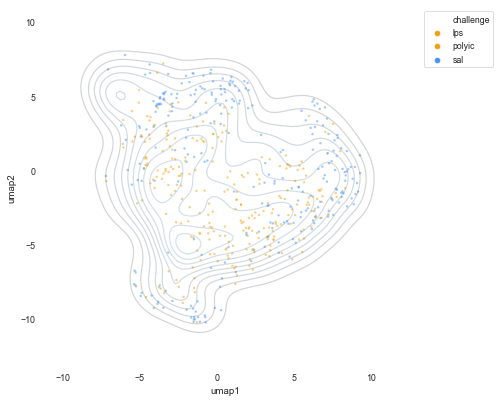

In [245]:
df = PB_eq
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = df1['umap1'], data2= df1['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = df[df['challenge'].isin(['sal', 'polyic'])], hue = 'challenge',
                palette = challenge_dict, x='umap1', y='umap2', marker='.',
                linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

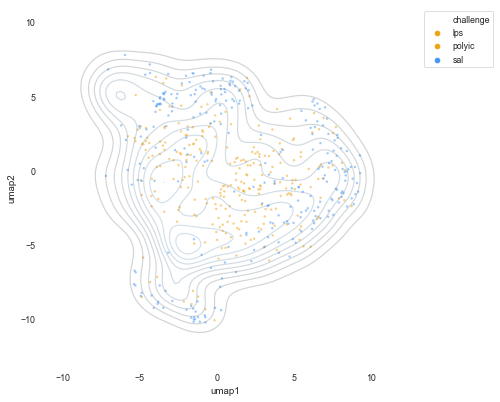

In [246]:
df = PB_eq
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = df1['umap1'], data2= df1['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = df[df['challenge'].isin(['sal', 'lps'])], hue = 'challenge',
                palette = challenge_dict, x='umap1', y='umap2', marker='.',
                linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

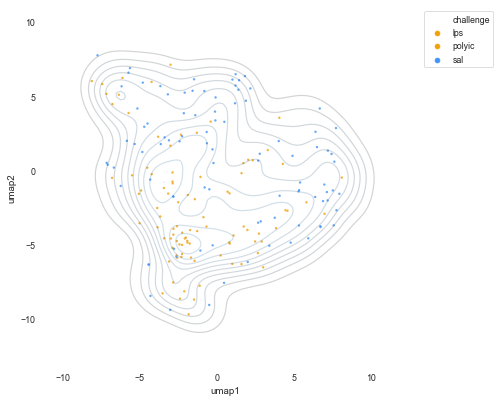

In [247]:
df = EV_eq
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = df1['umap1'], data2= df1['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = df[df['challenge'].isin(['sal', 'polyic'])], hue = 'challenge',
                palette = challenge_dict, x='umap1', y='umap2', marker='.',
                linewidth = 0, alpha = 0.8, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

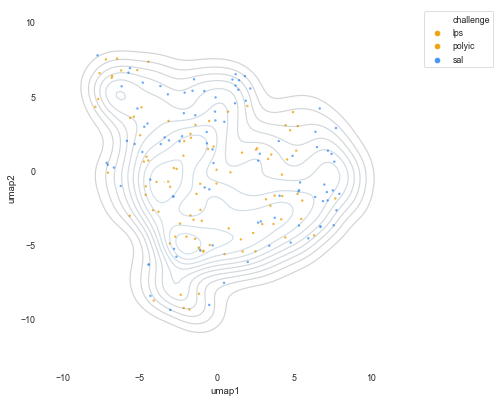

In [248]:
df = EV_eq
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = df1['umap1'], data2= df1['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = df[df['challenge'].isin(['sal', 'lps'])], hue = 'challenge',
                palette = challenge_dict, x='umap1', y='umap2', marker='.',
                linewidth = 0, alpha = 0.8, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

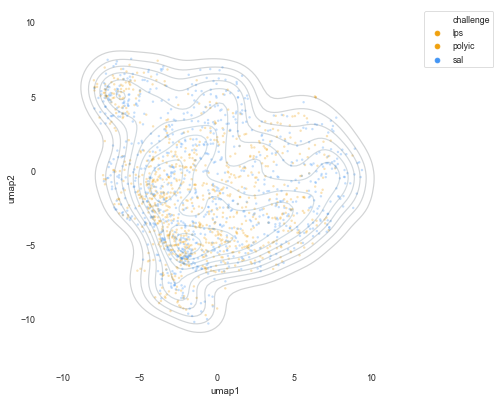

In [251]:
df = TIS_eq
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = df1['umap1'], data2= df1['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = df[df['challenge'].isin(['sal', 'polyic'])], hue = 'challenge',
                palette = challenge_dict, x='umap1', y='umap2', marker='.',
                linewidth = 0, alpha = 0.3, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

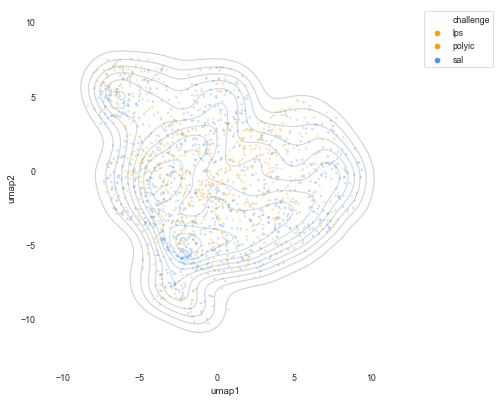

In [252]:
df = TIS_eq
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = df1['umap1'], data2= df1['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = df[df['challenge'].isin(['sal', 'lps'])], hue = 'challenge',
                palette = challenge_dict, x='umap1', y='umap2', marker='.',
                linewidth = 0, alpha = 0.3, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

In [217]:
df = TIS
sal = df[df['challenge'] == 'sal']
polyic = df[df['challenge'] == 'polyic']
lps = df[df['challenge']=='lps']

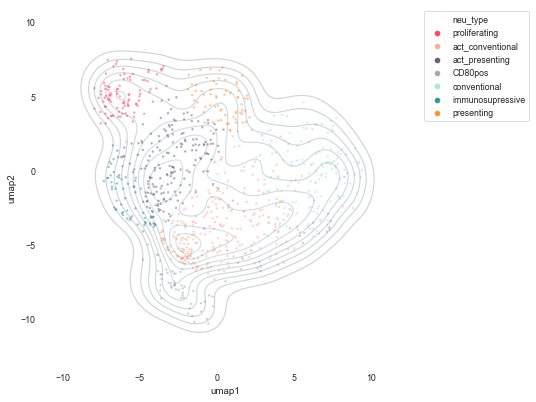

In [218]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = df1['umap1'], data2= df1['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = sal, hue = 'neu_type', palette = Neu_leiden2_dict, x='umap1', y='umap2', marker='.', linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

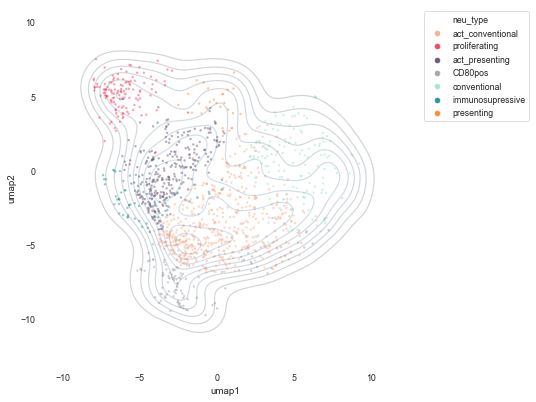

In [219]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = df1['umap1'], data2= df1['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = polyic, hue = 'neu_type', palette = Neu_leiden2_dict, x='umap1', y='umap2', marker='.', linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

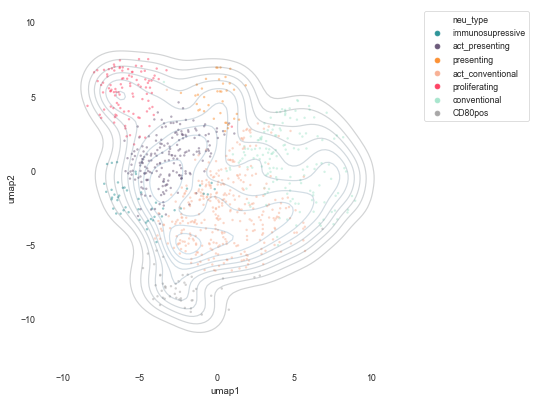

In [220]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = df1['umap1'], data2= df1['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = lps, hue = 'neu_type', palette = Neu_leiden2_dict, x='umap1', y='umap2', marker='.', linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Neutrophil cell counts

In [ ]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20201120_Neu_bl_maternal500wo_outliers.csv')
adata_df= pd.read_csv(umap_path)
adata_df.loc[:,['cage', 'id', 'Neu_leiden2']] = adata_df.loc[:,['cage', 'id', 'Neu_leiden2']].astype(str)

In [259]:
adata_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2,neu_CD11b,Neu_leiden2,umap1,umap2,neu_type
0,3.733698,3.482318,0.025405,0.000362,3.540359,2.862674,1.361506,1.185080,0.864763,0.312589,...,PB-EV,2,Neu,Neutrophils,PB-EV,mid,10,-3.580076,3.440799,act_presenting
1,5.030386,3.235032,0.000000,0.156082,3.322356,1.621257,2.450964,0.995553,0.636060,0.502439,...,PB-EV,10,B_cells,Neutrophils,PB-EV,mid,10,-4.999738,2.305276,act_presenting
2,3.762684,4.037537,0.113570,0.000362,3.977293,2.253136,2.469895,2.150812,0.965666,0.292154,...,PB-EV,2,Neu,Neutrophils,PB-EV,mid,8,-5.261172,-6.809465,CD80pos
3,2.139523,3.691419,0.052421,0.000362,1.301516,0.089487,0.008133,0.087274,0.224940,0.002609,...,PB-EV,8,Neu,Neutrophils,PB-EV,mid,0,-3.039389,1.380814,act_presenting
4,3.356221,1.707313,0.100837,0.000362,3.977293,1.615526,2.796888,0.087274,0.951465,0.269706,...,PB-EV,2,Neu,Neutrophils,PB-EV,mid,10,-4.738510,2.784621,act_presenting


In [260]:
neu_df = adata_df[adata_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T'])]

In [276]:
neu_mid = neu_df[neu_df['neu_CD11b'] == 'mid']
neu_mid.reset_index(inplace = True)

In [296]:
neu_mid.head(5)

,index,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,...,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2,neu_CD11b,Neu_leiden2,umap1,umap2,neu_type
0,0,3.733698,3.482318,0.025405,0.000362,3.540359,2.862674,1.361506,1.185080,0.864763,...,PB-EV,2,Neu,Neutrophils,PB-EV,mid,10,-3.580076,3.440799,act_presenting
1,1,5.030386,3.235032,0.000000,0.156082,3.322356,1.621257,2.450964,0.995553,0.636060,...,PB-EV,10,B_cells,Neutrophils,PB-EV,mid,10,-4.999738,2.305276,act_presenting
2,2,3.762684,4.037537,0.113570,0.000362,3.977293,2.253136,2.469895,2.150812,0.965666,...,PB-EV,2,Neu,Neutrophils,PB-EV,mid,8,-5.261172,-6.809465,CD80pos
3,3,2.139523,3.691419,0.052421,0.000362,1.301516,0.089487,0.008133,0.087274,0.224940,...,PB-EV,8,Neu,Neutrophils,PB-EV,mid,0,-3.039389,1.380814,act_presenting
4,4,3.356221,1.707313,0.100837,0.000362,3.977293,1.615526,2.796888,0.087274,0.951465,...,PB-EV,2,Neu,Neutrophils,PB-EV,mid,10,-4.738510,2.784621,act_presenting


In [307]:
mid_cell_counts = pd.DataFrame(data = neu_mid.groupby(['neu_type','challenge','compartment2','day','timePI','cage','id']).apply(len))
mid_cell_counts.reset_index(inplace = True)
mid_cell_counts.rename(columns = {0: 'counts'}, inplace = True)
mid_cell_counts['sample'] = mid_cell_counts['cage'].astype(str).str.cat(mid_cell_counts['id'].astype(str), sep= '_')
mid_cell_counts['sample'] = mid_cell_counts['sample'].str.cat(mid_cell_counts['day'], sep= '_')
mid_cell_counts['sample'] = mid_cell_counts['sample'].str.cat(mid_cell_counts['challenge'], sep= '_')
mid_cell_counts['sample'] = mid_cell_counts['sample'].str.cat(mid_cell_counts['timePI'], sep= '_')
mid_cell_counts['sample'] = mid_cell_counts['sample'].str.cat(mid_cell_counts['compartment2'], sep= '_')
mid_cell_counts['sample'] = mid_cell_counts['sample'].str.cat(mid_cell_counts['neu_type'], sep= '_')
sample_total = pd.DataFrame(data = mid_cell_counts.groupby(['sample']).sum())
sample_dict = sample_total.to_dict()
mid_cell_counts.loc[:,'sample_mid'] = mid_cell_counts['sample'].map(sample_dict['counts'])

In [309]:
mid_cell_counts[mid_cell_counts['sample'] == '6942_8_E10.5_sal_2hr_PB-EV_CD80pos']

,neu_type,challenge,compartment2,day,timePI,cage,id,counts,sample,sample_mid
50,CD80pos,sal,PB-EV,E10.5,2hr,6942,8,8,6942_8_E10.5_sal_2hr_PB-EV_CD80pos,8


In [310]:
mid_total_df = mid_cell_counts.loc[:, ['sample', 'counts']]
mid_total_df.set_index('sample', inplace = True)
mid_counts_dict = mid_total_df.to_dict()

In [302]:
mid_counts_dict['counts']

{'749_6_E12.5_lps_24hr_PB-EV': 1,
 '749_7_E12.5_lps_24hr_PB-EV': 2,
 '8238_5_E12.5_lps_2hr_PB-EV': 3,
 '8240_20_E12.5_lps_2hr_PB-EV': 7,
 '9582_12_E12.5_lps_2hr_PB-EV': 2,
 '1137_10_E14.5_lps_24hr_PB-EV': 2,
 '1139_18_E14.5_lps_2hr_PB-EV': 5,
 '1139_20_E14.5_lps_2hr_PB-EV': 14,
 '8240_13_E14.5_lps_2hr_PB-EV': 6,
 '1137_10_E14.5_lps_24hr_PL-EV': 1,
 '1139_18_E14.5_lps_2hr_PL-EV': 5,
 '8238_5_E12.5_lps_2hr_PL-T': 14,
 '8240_20_E12.5_lps_2hr_PL-T': 16,
 '9582_12_E12.5_lps_2hr_PL-T': 25,
 '1137_10_E14.5_lps_24hr_PL-T': 36,
 '2990_9_E14.5_lps_24hr_PL-T': 143,
 '2991_3_E14.5_lps_24hr_PL-T': 10,
 '438_3_E14.5_lps_24hr_PL-T': 9,
 '1139_18_E14.5_lps_2hr_PL-T': 34,
 '1139_20_E14.5_lps_2hr_PL-T': 22,
 '8240_13_E14.5_lps_2hr_PL-T': 11,
 '2847_1_E12.5_polyic_24hr_PB-EV': 1,
 '2847_3_E12.5_polyic_24hr_PB-EV': 4,
 '2850_19_E12.5_polyic_24hr_PB-EV': 1,
 '2848_7_E12.5_polyic_2hr_PB-EV': 2,
 '8238_2_E12.5_polyic_2hr_PB-EV': 5,
 '8239_9_E12.5_polyic_2hr_PB-EV': 12,
 '8241_19_E12.5_polyic_2hr_PB-EV': 4,
 

In [261]:
cell_counts = pd.DataFrame(data = neu_df.groupby(['neu_type', 'compartment2','day', 'challenge','timePI','cage', 'id']).apply(len))
cell_counts.reset_index(inplace = True)
cell_counts.rename(columns = {0: 'counts'}, inplace = True)
cell_counts['sample'] = cell_counts['cage'].astype(str).str.cat(cell_counts['id'].astype(str), sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['day'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['challenge'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['timePI'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['compartment2'], sep= '_')
sample_total = pd.DataFrame(data = cell_counts.groupby(['sample']).sum())
sample_dict = sample_total.to_dict()
cell_counts.loc[:,'sample_total'] = cell_counts['sample'].map(sample_dict['counts'])
cell_counts['frac_of_neutrophils'] = cell_counts['counts']/cell_counts['sample_total']                                             

In [262]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20201103_Challengemaleandfemcombmaternal500wo_outliers_counts_per_sample_meta_clust.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
full_cell_counts= pd.read_csv(counts_filepath)
full_cell_counts.loc[:, ['cage', 'id']] = full_cell_counts.loc[:, ['cage', 'id']].astype(str)
samp_total_df = full_cell_counts.loc[:, ['sample', 'sample_total']]
samp_total_df.set_index('sample', inplace = True)
total_counts_dict = samp_total_df.to_dict()

In [264]:
cell_counts.loc[:,'full_sample_total'] = cell_counts.loc[:,'sample'].map(total_counts_dict['sample_total'])
cell_counts['frac_of_immune'] = cell_counts['counts']/cell_counts['full_sample_total']                                          

In [311]:
cell_counts['sample_neu_id'] = cell_counts['sample'].str.cat(cell_counts['neu_type'], sep= '_')

In [312]:
cell_counts.loc[:,'CD11bmid_counts'] = cell_counts.loc[:,'sample_neu_id'].map(mid_counts_dict['counts'])

In [313]:
cell_counts['CD11bhi_counts'] = cell_counts['counts'] - cell_counts['CD11bmid_counts']

In [314]:
cell_counts['CD11bmid_frac_of_neu'] = cell_counts['CD11bmid_counts']/cell_counts['sample_total']
cell_counts['CD11bmid_frac_of_immune'] = cell_counts['CD11bmid_counts']/cell_counts['full_sample_total']                                          
cell_counts['CD11bhi_frac_of_neu'] = cell_counts['CD11bhi_counts']/cell_counts['sample_total']
cell_counts['CD11bhi_frac_of_immune'] = cell_counts['CD11bhi_counts']/cell_counts['full_sample_total']  

In [315]:
cell_counts[cell_counts['sample'] == '6942_8_E10.5_sal_2hr_PB-EV']

,neu_type,compartment2,day,challenge,timePI,cage,id,counts,sample,sample_total,frac_of_neutrophils,full_sample_total,frac_of_immune,CD11bmid_counts,CD11bmid_frac_of_neu,CD11bmid_frac_of_immune,CD11bhi_counts,CD11bhi_frac_of_neu,CD11bhi_frac_of_immune,sample_neu_id
0,CD80pos,PB-EV,E10.5,sal,2hr,6942,8,8,6942_8_E10.5_sal_2hr_PB-EV,74,0.108108,494.0,0.016194,8.0,0.108108,0.016194,0.0,0.000000,0.000000,6942_8_E10.5_sal_2hr_PB-EV_CD80pos
174,act_conventional,PB-EV,E10.5,sal,2hr,6942,8,1,6942_8_E10.5_sal_2hr_PB-EV,74,0.013514,494.0,0.002024,1.0,0.013514,0.002024,0.0,0.000000,0.000000,6942_8_E10.5_sal_2hr_PB-EV_act_conventional
351,act_presenting,PB-EV,E10.5,sal,2hr,6942,8,13,6942_8_E10.5_sal_2hr_PB-EV,74,0.175676,494.0,0.026316,12.0,0.162162,0.024291,1.0,0.013514,0.002024,6942_8_E10.5_sal_2hr_PB-EV_act_presenting
536,conventional,PB-EV,E10.5,sal,2hr,6942,8,20,6942_8_E10.5_sal_2hr_PB-EV,74,0.270270,494.0,0.040486,17.0,0.229730,0.034413,3.0,0.040541,0.006073,6942_8_E10.5_sal_2hr_PB-EV_conventional
820,presenting,PB-EV,E10.5,sal,2hr,6942,8,30,6942_8_E10.5_sal_2hr_PB-EV,74,0.405405,494.0,0.060729,29.0,0.391892,0.058704,1.0,0.013514,0.002024,6942_8_E10.5_sal_2hr_PB-EV_presenting
966,proliferating,PB-EV,E10.5,sal,2hr,6942,8,2,6942_8_E10.5_sal_2hr_PB-EV,74,0.027027,494.0,0.004049,2.0,0.027027,0.004049,0.0,0.000000,0.000000,6942_8_E10.5_sal_2hr_PB-EV_proliferating


In [316]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20201120_maternalNeu_edited_counts_per_sample.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
cell_counts.to_csv(counts_filepath, index = False)    

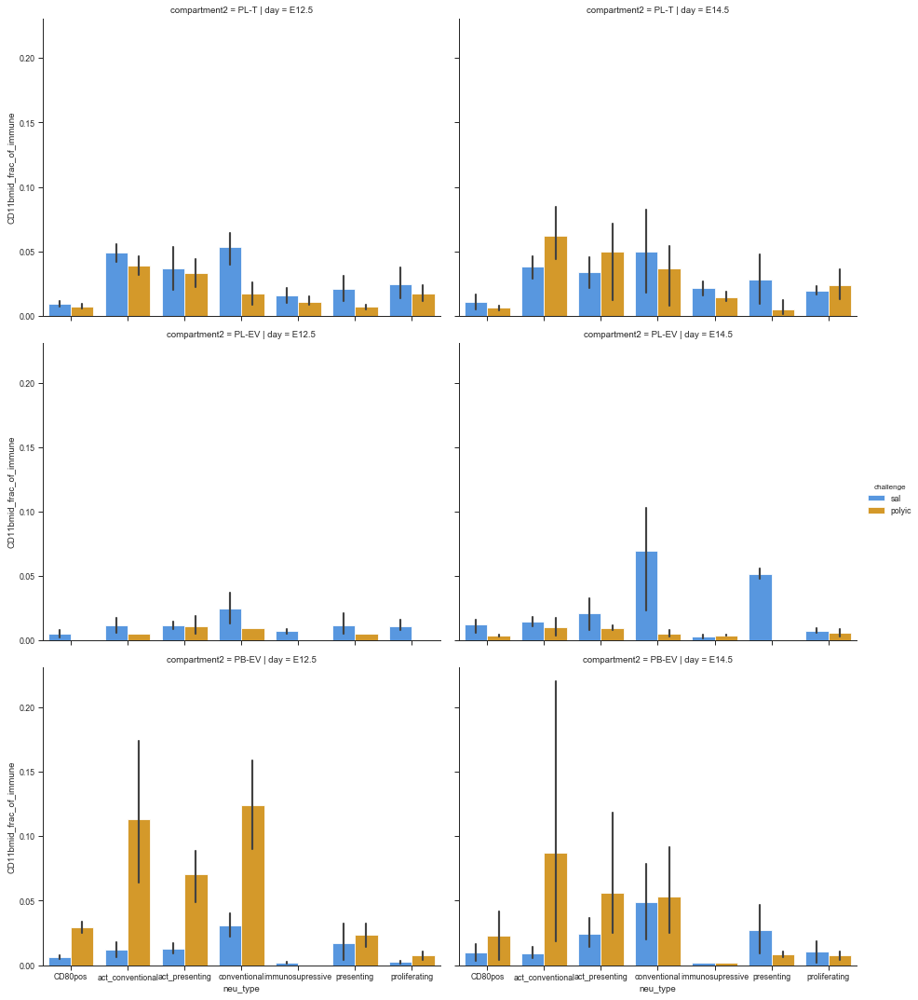

In [319]:
sns.set_style("ticks")
g = sns.catplot(x='neu_type', y='CD11bmid_frac_of_immune', row = 'compartment2', 
                hue_order = ['sal', 'polyic'], col= 'day',
                row_order = ['PL-T', 'PL-EV', 'PB-EV'],
                data= cell_counts[cell_counts['day'].isin(['E12.5', 'E14.5']) & 
                                                               cell_counts['challenge'].isin(['sal', 'polyic'])& 
                                                               cell_counts['timePI'].isin(['2hr'])], 
                kind='bar', hue = 'challenge', sharey = True, palette = challenge_dict,
                height=5, aspect=1.3)

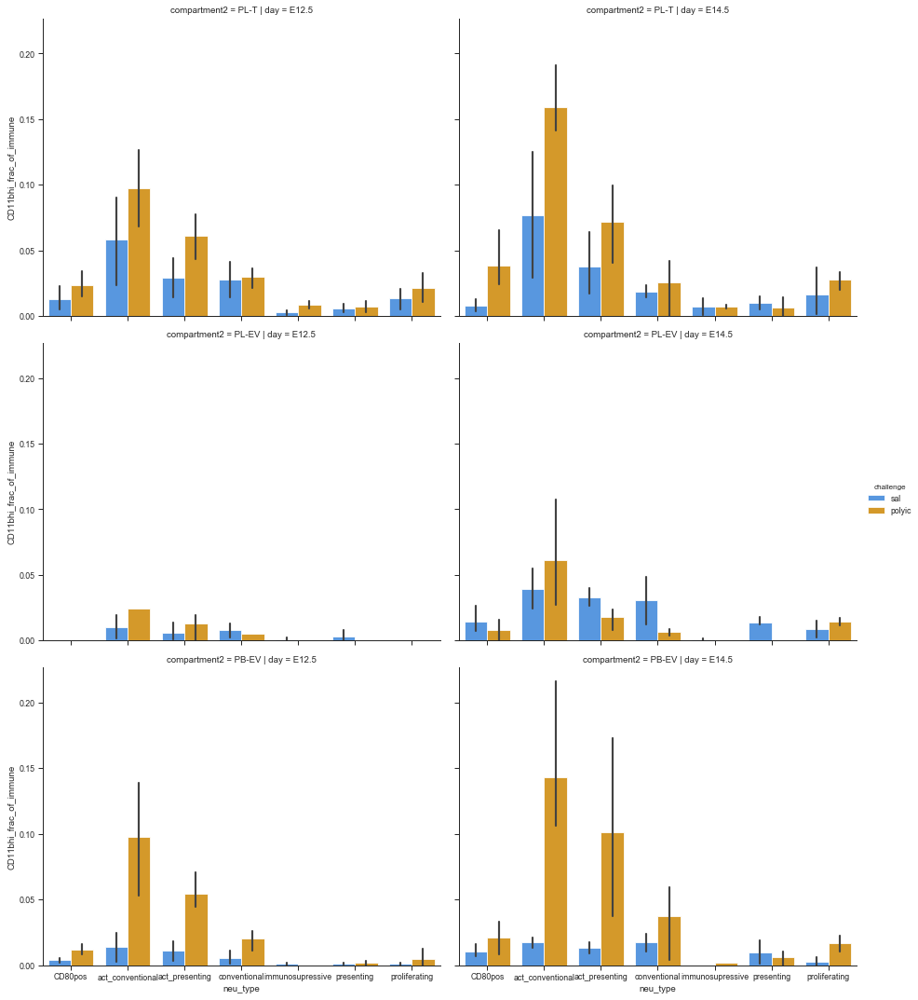

In [321]:
sns.set_style("ticks")
g = sns.catplot(x='neu_type', y='CD11bhi_frac_of_immune', row = 'compartment2', 
                hue_order = ['sal', 'polyic'], col= 'day',
                row_order = ['PL-T', 'PL-EV', 'PB-EV'],
                data= cell_counts[cell_counts['day'].isin(['E12.5', 'E14.5']) & 
                                                               cell_counts['challenge'].isin(['sal', 'polyic'])& 
                                                               cell_counts['timePI'].isin(['2hr'])], 
                kind='bar', hue = 'challenge', sharey = True, palette = challenge_dict,
                height=5, aspect=1.3)

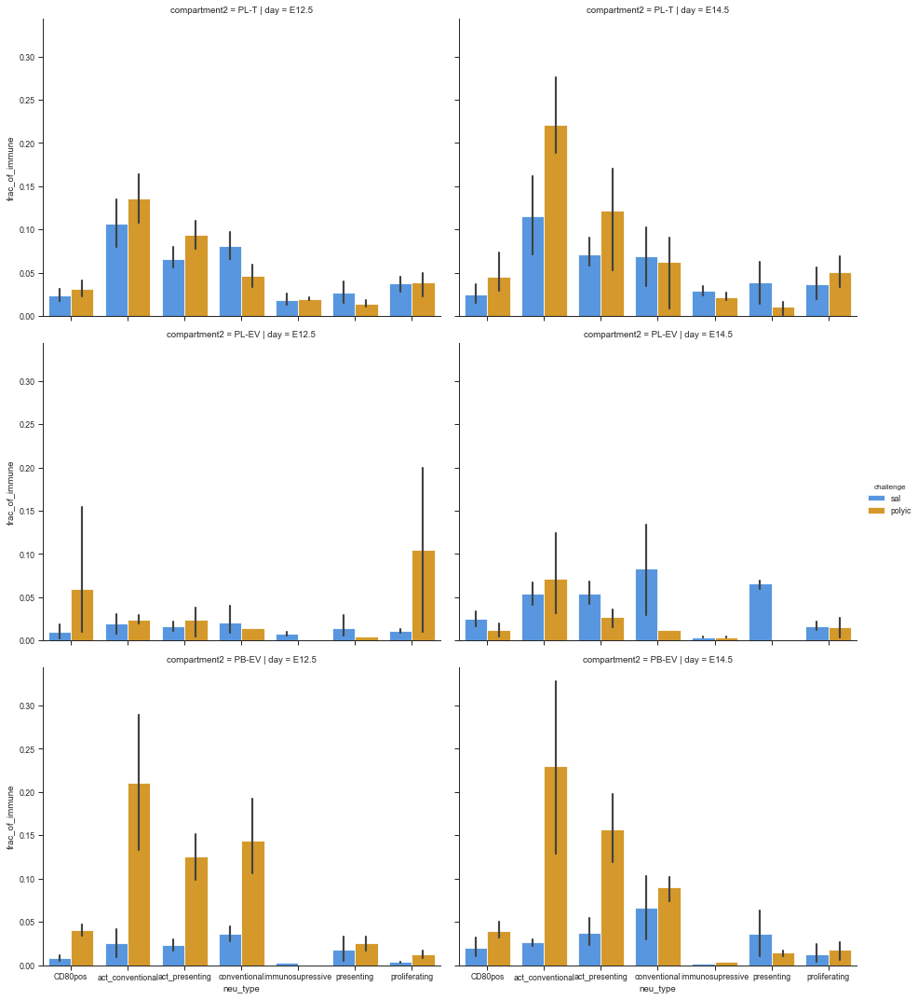

In [322]:
sns.set_style("ticks")
g = sns.catplot(x='neu_type', y='frac_of_immune', row = 'compartment2', 
                hue_order = ['sal', 'polyic'], col= 'day',
                row_order = ['PL-T', 'PL-EV', 'PB-EV'],
                data= cell_counts[cell_counts['day'].isin(['E12.5', 'E14.5']) & 
                                                               cell_counts['challenge'].isin(['sal', 'polyic'])& 
                                                               cell_counts['timePI'].isin(['2hr'])], 
                kind='bar', hue = 'challenge', sharey = True, palette = challenge_dict,
                height=5, aspect=1.3)

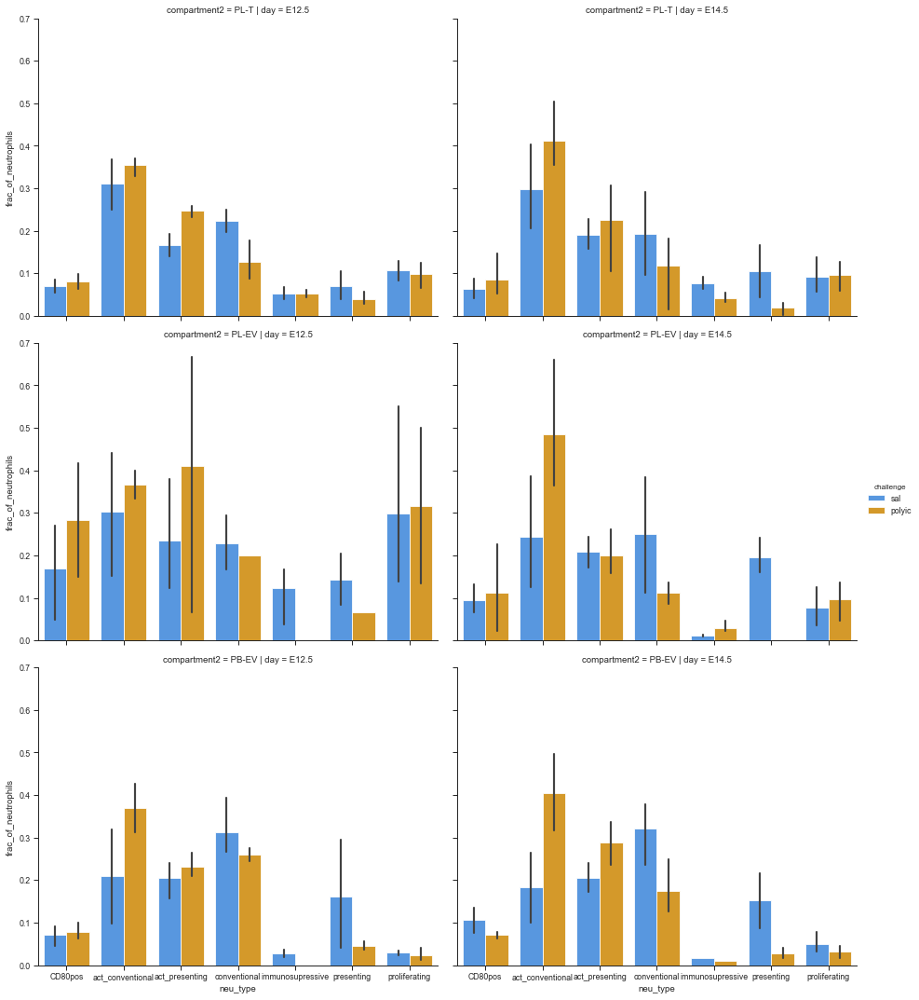

In [324]:
sns.set_style("ticks")
g = sns.catplot(x='neu_type', y='frac_of_neutrophils', row = 'compartment2', 
                hue_order = ['sal', 'polyic'], col= 'day',
                row_order = ['PL-T', 'PL-EV', 'PB-EV'],
                data= cell_counts[cell_counts['day'].isin(['E12.5', 'E14.5']) & 
                                                               cell_counts['challenge'].isin(['sal', 'polyic'])& 
                                                               cell_counts['timePI'].isin(['2hr'])], 
                kind='bar', hue = 'challenge', sharey = True, palette = challenge_dict,
                height=5, aspect=1.3)

In [63]:
clustering =  [ 'CD62L', 'IdU', 'MHCII', 'CD80', 'CD40', 'PD-L1']
neu_adata.obsm['cluster_channels'] = neu_adata[:, clustering].X

In [64]:
high_neu_cd11b = neu_adata[neu_adata.obs['neu_CD11b']== 'high']
mid_neu_cd11b = neu_adata[neu_adata.obs['neu_CD11b']== 'mid']

In [65]:
sc.pp.neighbors(high_neu_cd11b, n_neighbors = 20, use_rep= 'cluster_channels', random_state = 1)
sc.pp.neighbors(mid_neu_cd11b, n_neighbors = 20, use_rep= 'cluster_channels', random_state = 1)

In [66]:
sc.tl.umap(high_neu_cd11b, random_state = 1)
sc.tl.umap(mid_neu_cd11b, random_state = 1)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/anndata/core/anndata.py:846: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


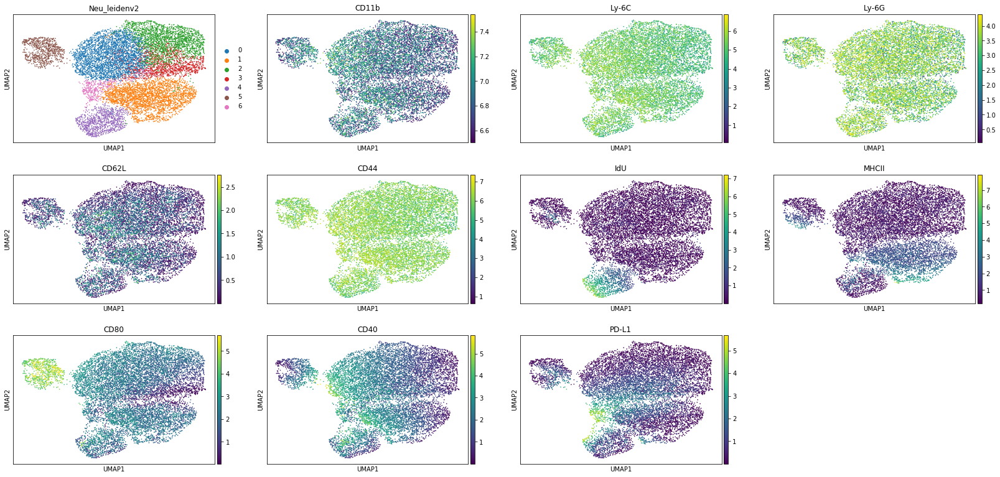

In [80]:
sc.tl.leiden(high_neu_cd11b, resolution=0.3, key_added = 'Neu_leidenv2', random_state = 1)
sc.pl.umap(high_neu_cd11b, color = ['Neu_leidenv2', 'CD11b','Ly-6C', 'Ly-6G', 'CD62L', 'CD44', 'IdU', 'MHCII', 'CD80', 'CD40', 'PD-L1'], use_raw = False)

In [83]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
neu_adata_path = os.path.join(subsample_path, '20201116_CD11bhighNeu_maternal500wo_outliers.h5ad')
high_neu_cd11b.write(neu_adata_path)

In [81]:
sc.tl.leiden(mid_neu_cd11b, resolution=0.3, key_added = 'Neu_leidenv2', random_state = 1)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/anndata/core/anndata.py:846: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


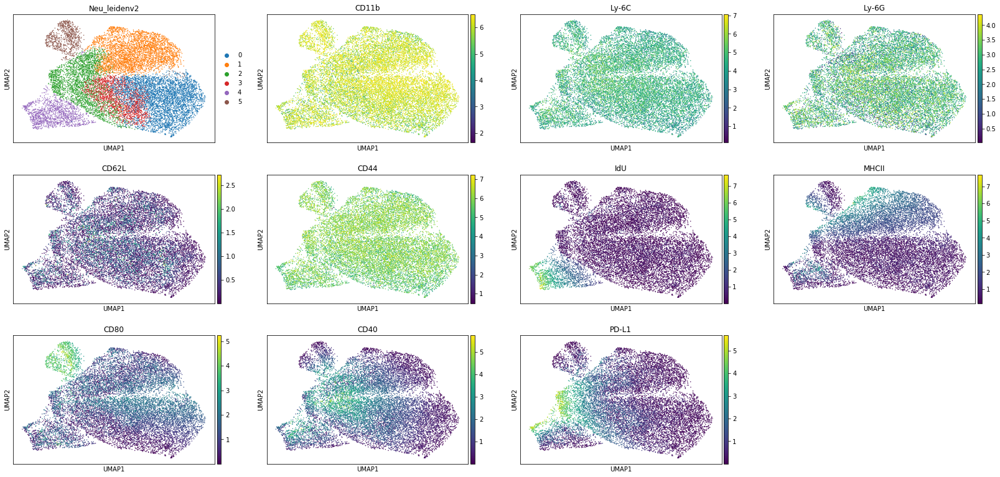

In [82]:
sc.pl.umap(mid_neu_cd11b, color = ['Neu_leidenv2', 'CD11b','Ly-6C', 'Ly-6G', 'CD62L', 'CD44', 'IdU', 'MHCII', 'CD80', 'CD40', 'PD-L1'], use_raw = False)

In [84]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
neu_adata_path = os.path.join(subsample_path, '20201116_CD11bmidNeu_maternal500wo_outliers.h5ad')
mid_neu_cd11b.write(neu_adata_path)

In [85]:
humap_pd = pd.DataFrame(data = high_neu_cd11b.obsm['X_umap'], columns = ['umap1', 'umap2']).set_index(high_neu_cd11b.obs_names)
hadata_df = pd.DataFrame(data = high_neu_cd11b.X, columns = high_neu_cd11b.var_names).set_index(high_neu_cd11b.obs_names)
hadata_df = pd.concat([hadata_df, high_neu_cd11b.obs, humap_pd], axis = 1, join = 'outer', copy = False)

In [86]:
mumap_pd = pd.DataFrame(data = mid_neu_cd11b.obsm['X_umap'], columns = ['umap1', 'umap2']).set_index(mid_neu_cd11b.obs_names)
madata_df = pd.DataFrame(data = mid_neu_cd11b.X, columns = mid_neu_cd11b.var_names).set_index(mid_neu_cd11b.obs_names)
madata_df = pd.concat([madata_df, mid_neu_cd11b.obs, mumap_pd], axis = 1, join = 'outer', copy = False)

In [87]:
hadata_df.rename(columns = {'Neu_leidenv2': 'Neu_leiden2'}, inplace = True)
madata_df.rename(columns = {'Neu_leidenv2': 'Neu_leiden2'}, inplace = True)

In [88]:
hadata_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,cell_type,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2,neu_CD11b,Neu_leiden2,umap1,umap2
index,,,,,,,,,,,,,,,,,,,,,
5-4,0.939062,3.507586,0.000000,0.082078,2.889052,4.098330,0.759732,2.215454,2.294682,0.031273,...,Neutrophils Ly6Ghi,PL_F-T,2,Neu,Neutrophils,PL-whole,high,1,1.566263,-6.293979
9-4,0.000000,3.860624,0.000000,0.487663,1.162592,3.559613,2.702580,0.078261,2.442770,0.540142,...,Neutrophils Ly6Ghi,PL_F-T,2,Neu,Neutrophils,PL-whole,high,0,-1.019355,1.131370
17-4,0.810826,3.863246,0.229861,0.082078,2.851507,4.190165,2.543911,1.235470,2.367692,0.534682,...,Neutrophils Ly6Ghi,PL_F-T,2,Neu,Neutrophils,PL-whole,high,0,-3.969312,0.550590
23-4,0.000000,2.969703,0.000000,0.082078,2.539070,3.872865,0.050134,0.333150,1.824233,1.153400,...,Neutrophils Ly6Ghi,PL_F-T,2,Neu,Neutrophils,PL-whole,high,1,1.079614,-3.763002
24-4,0.000000,2.803952,0.000000,0.082078,1.712116,3.756561,0.649879,0.731060,2.183916,0.514451,...,Neutrophils Ly6Ghi,PL_F-T,2,Neu,Neutrophils,PL-whole,high,3,2.938486,1.558866


In [89]:
madata_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,cell_type,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2,neu_CD11b,Neu_leiden2,umap1,umap2
index,,,,,,,,,,,,,,,,,,,,,
16,3.733698,3.482318,0.025405,0.000362,3.540359,2.862674,1.361506,1.185081,0.864763,0.312589,...,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,mid,1,-0.625436,5.606119
46,5.030386,3.235032,0.000000,0.156082,3.322356,1.621257,2.450964,0.995553,0.636060,0.502439,...,Neutrophils Ly6Ghi,PB-EV,10,B_cells,Neutrophils,PB-EV,mid,1,-2.460867,5.197485
190,3.762684,4.037537,0.113570,0.000362,3.977293,2.253136,2.469895,2.150812,0.965666,0.292154,...,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,mid,5,-5.822210,4.605706
240,2.139523,3.691419,0.052421,0.000362,1.301516,0.089487,0.008133,0.087274,0.224940,0.002609,...,Neutrophils Ly6Gmid,PB-EV,8,Neu,Neutrophils,PB-EV,mid,5,-5.797878,4.957665
68-1,3.356221,1.707314,0.100837,0.000362,3.977293,1.615526,2.796888,0.087274,0.951465,0.269706,...,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,mid,1,-2.089777,5.653416


In [90]:
hadata_df.loc[:, ['Neu_leiden2', 'cage', 'id']] = hadata_df.loc[:, ['Neu_leiden2', 'cage', 'id']] .astype(str)
madata_df.loc[:, ['Neu_leiden2', 'cage', 'id']] = madata_df.loc[:, ['Neu_leiden2', 'cage', 'id']] .astype(str)

In [91]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
hneu_adata_path = os.path.join(subsample_path, '20201116_CD11bhighNeu_maternal500wo_outliers.csv')
hadata_df.to_csv(hneu_adata_path, index = False)
mneu_adata_path = os.path.join(subsample_path, '20201116_CD11bmidNeu_maternal500wo_outliers.csv')
madata_df.to_csv(mneu_adata_path, index = False)

In [92]:
hNeu_name_dict = {'0': 'CD11bhi_conventional',
'1': 'CD11bhi_presenting',
'2': 'CD11bhi_conventional',                                       
'3': 'CD11bhi_conventional',
'4': 'CD11bhi_proliferating',
'5': 'CD11bhi_CD80pos',
'6': 'CD11bhi_immunosupressive'}

In [93]:
mNeu_name_dict = {'0': 'CD11bmid_conventional',
'1': 'CD11bmid_presenting',
'2': 'CD11bmid_immunosupressive',                                       
'3': 'CD11bmid_conventional',
'4': 'CD11bmid_proliferating',
'5': 'CD11bmid_CD80pos'}

In [94]:
hadata_df.loc[:,'neu_type'] = hadata_df['Neu_leiden2'].map(hNeu_name_dict)
madata_df.loc[:,'neu_type'] = madata_df['Neu_leiden2'].map(mNeu_name_dict)

In [95]:
hadata_df.to_csv(hneu_adata_path, index = False)
madata_df.to_csv(mneu_adata_path, index = False)

In [98]:
hadata_df.drop(columns = ['umap1', 'umap2'], inplace = True)
madata_df.drop(columns = ['umap1', 'umap2'], inplace = True)

In [101]:
neu_full_df = pd.concat([hadata_df, madata_df])

In [102]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
full_neu_adata_path = os.path.join(subsample_path, '20201116_full_Neu_maternal500wo_outliers.csv')
neu_full_df.to_csv(full_neu_adata_path, index = False)

In [116]:
Neu_leiden2_dict = {'CD11bhi_conventional': '#F8B195',
                    'CD11bmid_conventional': '#C06C84', 
                    'CD11bhi_presenting': '#FC9134',                                      
                    'CD11bmid_presenting':'#A8E6CE',
                    'CD11bhi_proliferating':'#6C5B7B',
                    'CD11bmid_proliferating': '#FE4365',
                    'CD11bhi_CD80pos': '#A8A7A7',
                    'CD11bmid_CD80pos': '#2F9599',
                    'CD11bhi_immunosupressive':'#6b31bc',
                    'CD11bmid_immunosupressive': '#117f2d'}

In [2]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20200508_maternal500_fetal_wo_outliers.csv')
adata_df = pd.read_csv(umap_path)
adata_df.loc[:, ['cage', 'id']] = adata_df.loc[:, ['cage', 'id']].astype(str)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (42) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [3]:
adata_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,IdU_status,cell_descript,test_status,sample,cell_type,compartment,umap1,umap2,cell_type_v2,compartment2
0,4.043577,2.675877,0.000000,0.000362,0.512983,0.089487,0.008133,0.087274,0.004988,0.002609,...,IdU-,B cells CD11b-_E12.5_sal_24hr_3576_15_PB_EV,test,3576_15_E12.5_sal_24hr_PB-EV,B cells IgMneg,PB-EV,-7.261047,0.630245,B cells,PB-EV
1,0.817134,1.500582,0.267541,0.000362,0.512983,0.089487,0.008133,0.087274,0.004988,0.002609,...,IdU-,B cells CD11b-_E12.5_sal_24hr_3576_15_PB_EV,test,3576_15_E12.5_sal_24hr_PB-EV,B cells IgMneg,PB-EV,-6.886134,1.104040,B cells,PB-EV
2,4.282589,3.040544,0.000000,0.000362,0.872199,0.089487,0.062601,0.804102,0.023428,0.002609,...,IdU-,B cells CD11b-_E12.5_sal_24hr_3576_15_PB_EV,test,3576_15_E12.5_sal_24hr_PB-EV,B cells IgMneg,PB-EV,-8.550488,0.054187,B cells,PB-EV
3,4.141450,2.837712,0.000000,0.288750,1.095751,0.089487,0.008133,0.087274,0.055609,0.002609,...,IdU-,B cells CD11b-_E12.5_sal_24hr_3576_15_PB_EV,test,3576_15_E12.5_sal_24hr_PB-EV,B cells IgMneg,PB-EV,-7.261248,0.605229,B cells,PB-EV
4,4.288015,3.259453,0.000000,0.000362,0.512983,0.089487,0.008133,0.087274,0.004988,0.002609,...,IdU-,B cells CD11b-_E12.5_sal_24hr_3576_15_PB_EV,test,3576_15_E12.5_sal_24hr_PB-EV,B cells IgMneg,PB-EV,-6.507263,1.186826,B cells,PB-EV


In [4]:
adata_df['neu_CD11b'] = 'mid'
CD11b_mask_all = ((adata_df['CD11b'] >= 6.5) & (adata_df['cell_type_v2']=='Neutrophils'))
adata_df['neu_CD11b'][CD11b_mask_all] = 'high'

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [7]:
adata_df.to_csv(umap_path, index = False)

In [7]:
leiden_color_dictv2 = {'B cells': '#355C7D',
 'CD4+ T cells': '#F8B195',
 'CD8+ T cells': '#F67280',
 'Eosinophils': '#A30059',
 'Basophils': '#b4b4ee',
 'Monocytes': '#6C5B7B',
 'NK cells': '#b4d1ee',
 'Neutrophils': '#999097'}

In [9]:
neu_df = adata_df[(adata_df['test_status'] == 'test') & 
                    adata_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T']) &  
                    (adata_df['origin'] == 'maternal')&
                   (adata_df['cell_type_v2'] == 'Neutrophils')]

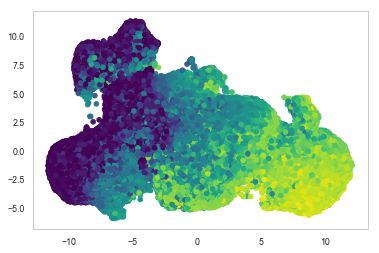

In [15]:
points = plt.scatter(adata_df['umap1'], adata_df['umap2'], c = adata_df['CD11b'], cmap='viridis')

In [ ]:
sns.set_context('paper', font_scale= 1)
g = sns.relplot(x='umap1', y= 'umap2', hue = 'median', col= 'marker', data= neu_melt,
                height=4, aspect=1, kind="scatter", palette = 'viridis', col_wrap=4,
                marker='.', size = 0.1, linewidth = 0, alpha = 0.5, legend = False).set_titles('{col_name}')
cax = g.fig.add_axes([1, .11, 0.015, 0.15])
plt.colorbar(points, cax=cax)
sns.despine(g, left=True, bottom=True)

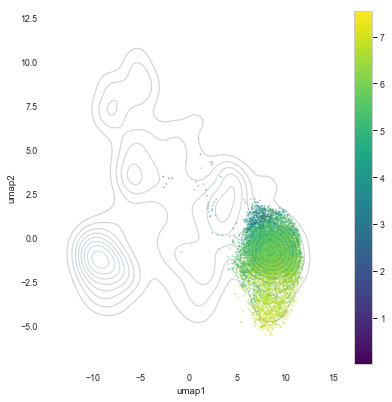

In [19]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = clean_df['umap1'], data2 = clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)

g = sns.scatterplot(data = clean_df[clean_df['cell_type_v2']=='Neutrophils'], 
                hue = 'CD11b', palette = 'viridis', 
                x='umap1', y='umap2', marker='.', size = 0.1, 
                linewidth = 0, alpha = 0.5, legend = False, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
plt.colorbar(points)

In [2]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
numap_path = os.path.join(subsample_path, '20201028_Neu_maternal500wo_outliers.csv')
neu_df= pd.read_csv(numap_path)
neu_df.loc[:, ['cage', 'id']] = neu_df.loc[:, ['cage', 'id']].astype(str)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (42) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [21]:
neu_clean_df= neu_df[(neu_df['test_status'] == 'test') & 
                    neu_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T']) & 
                    (neu_df['origin'] == 'maternal')]

In [22]:
neu_clean_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,cell_type,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2,Neu_leiden2,umap1,umap2,neu_type
0,3.733698,3.482318,0.025405,0.000362,3.540359,2.862674,1.361506,1.185080,0.864763,0.312589,...,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,1,-2.699303,3.358642,presenting
1,5.030386,3.235032,0.000000,0.156082,3.322356,1.621257,2.450964,0.995553,0.636060,0.502439,...,Neutrophils Ly6Ghi,PB-EV,10,B_cells,Neutrophils,PB-EV,1,-2.431082,2.310327,presenting
2,3.762684,4.037537,0.113570,0.000362,3.977293,2.253136,2.469895,2.150812,0.965666,0.292154,...,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,6,-0.736832,-11.784729,CD80pos
3,2.139523,3.691419,0.052421,0.000362,1.301516,0.089487,0.008133,0.087274,0.224940,0.002609,...,Neutrophils Ly6Gmid,PB-EV,8,Neu,Neutrophils,PB-EV,6,-1.362637,0.894879,CD80pos
4,3.356221,1.707313,0.100837,0.000362,3.977293,1.615526,2.796888,0.087274,0.951465,0.269706,...,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,1,-3.026530,3.094898,presenting


In [60]:
neu_clean_df['neu_CD11b'] = 'mid'
CD11b_mask = (neu_clean_df['CD11b'] >= 6.5) 
neu_clean_df['neu_CD11b'][CD11b_mask] = 'high'

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [33]:
neu_class_dict = {'high': '#2c2145',
                   'mid': '#babdc2'}

In [31]:
clean_df['CD11b'].head(5)

1526    0.758481
1527    4.243958
1528    0.857384
1529    0.719870
1530    5.943838
Name: CD11b, dtype: float64

In [58]:
clean_df['neu_CD11b'] = 'mid'
CD11b_mask_all = ((clean_df['CD11b'] >= 6.5) & (clean_df['cell_type_v2']=='Neutrophils'))
clean_df['neu_CD11b'][CD11b_mask_all] = 'high'

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


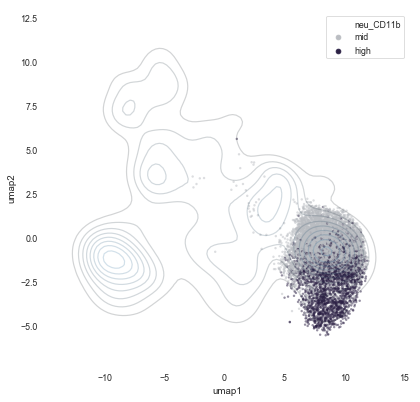

In [62]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = clean_df['umap1'], data2 = clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)

g = sns.scatterplot(data = clean_df[clean_df['cell_type_v2']=='Neutrophils'], 
                hue = 'neu_CD11b', palette = neu_class_dict, 
                x='umap1', y='umap2', marker='.', 
                linewidth = 0, alpha = 0.5,  ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})

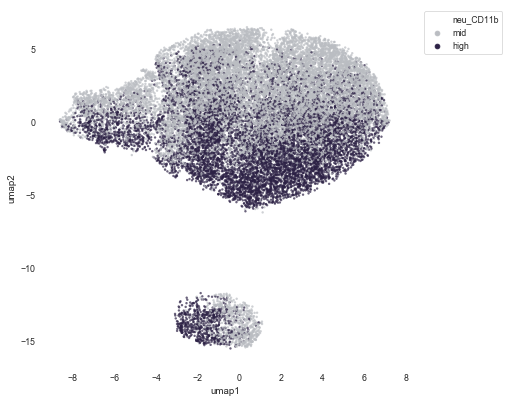

In [61]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.scatterplot(x='umap1', y='umap2', 
                data = neu_clean_df, 
                hue = 'neu_CD11b',
                palette = neu_class_dict, 
                marker='.', linewidth = 0, alpha = 0.7)
sns.set_style("whitegrid", {'axes.grid' : False})
sns.despine(f, left=True, bottom=True)
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

In [3]:
Neu_leiden2_dict = {'act_conventional': '#F8B195',
'presenting': '#FC9134',
'Ly6Glow': '#C06C84',                                       
'conventional':'#A8E6CE',
'act_presenting':'#6C5B7B',
'proliferating': '#FE4365',
'CD80pos': '#A8A7A7',
'immunosupressive': '#2F9599'}

In [63]:
class_cell_counts = pd.DataFrame(data = neu_clean_df.groupby(['neu_type','neu_CD11b', 'challenge','timePI','cage','id']).apply(len))
class_cell_counts.reset_index(inplace = True)
class_cell_counts.rename(columns = {0: 'counts'}, inplace = True)
class_cell_counts['sample'] = class_cell_counts['neu_type'].astype(str).str.cat(class_cell_counts['challenge'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['timePI'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['cage'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['id'], sep= '_')

In [64]:
sample_total = pd.DataFrame(data = class_cell_counts.groupby(['sample']).sum())
sample_dict = sample_total.to_dict()
class_cell_counts.loc[:,'sample_total'] = class_cell_counts['sample'].map(sample_dict['counts'])
class_cell_counts['frac_of_comp_sample'] = class_cell_counts['counts']/class_cell_counts['sample_total'] 

In [65]:
bl_counts_piv = class_cell_counts.pivot_table(index = ['neu_type', 'challenge','timePI','cage','id'], columns = 'neu_CD11b', values = 'frac_of_comp_sample')
bl_counts_piv.reset_index(inplace = True)
bl_counts_piv.columns = bl_counts_piv.columns.astype(str)
bl_counts_piv.loc[:,'high': 'mid'] = bl_counts_piv.loc[:,'high': 'mid'].fillna(0)
bl_counts_piv.loc[:, 'id':'cage'] = bl_counts_piv.loc[:, 'id':'cage'].astype('str')
composite = bl_counts_piv.groupby(['neu_type']).agg(['mean', 'sem'])
mean_sem_comp = composite.reorder_levels([1, 0], axis = 1)
composite_T = mean_sem_comp['mean'].transpose()
composite_T.reset_index(inplace = True)

In [70]:
composite_T.sum(axis = 0)

neu_type
index               highmid
CD80pos                   1
Ly6Glow                   1
act_conventional          1
act_presenting            1
conventional              1
immunosupressive          1
presenting                1
proliferating             1
dtype: object

In [71]:
int_to_mo_class = composite_T[['index']].to_dict()
bars_dict = {}
for mo_class in composite_T.index:
    bars_dict[mo_class] = composite_T.iloc[mo_class, 1:]
height_dict = {}
for mo_class in composite_T.index:
    height_dict[mo_class] = composite_T.iloc[mo_class+1:,1:].sum().tolist()

In [73]:
bars_dict

{0: neu_type
 CD80pos             0.433755
 Ly6Glow             0.186211
 act_conventional    0.597696
 act_presenting      0.593818
 conventional        0.323922
 immunosupressive    0.195063
 presenting          0.220079
 proliferating         0.3215
 Name: 0, dtype: object, 1: neu_type
 CD80pos             0.566245
 Ly6Glow             0.813789
 act_conventional    0.402304
 act_presenting      0.406182
 conventional        0.676078
 immunosupressive    0.804937
 presenting          0.779921
 proliferating         0.6785
 Name: 1, dtype: object}

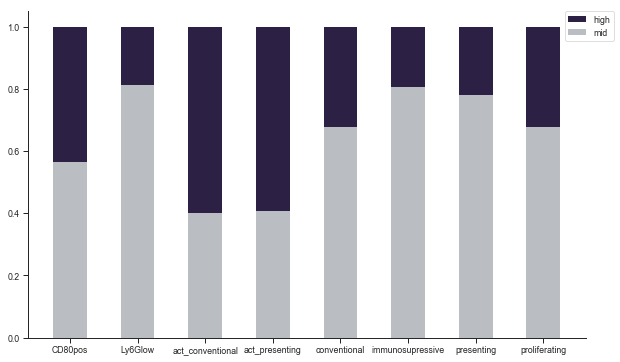

In [74]:
sns.set_style("ticks")
plt.figure(figsize=(10,6)) 
# The position of the bars on the x-axis
r = [0, 0.2, 0.4, 0.6, 0.8, 1.0, 1.2, 1.4]
 
# Names of group and bar width
names = ['CD80pos',           
 'Ly6Glow',    
 'act_conventional',
 'act_presenting',
 'conventional',
 'immunosupressive',
 'presenting',
 'proliferating']

barWidth = 0.10

for mo_class in composite_T.index:
    plt.bar(r, bars_dict[mo_class], color = neu_class_dict[int_to_mo_class['index'][mo_class]], bottom = height_dict[mo_class], width=barWidth, linewidth = 0)
plt.xticks(r, names);
plt.legend(composite_T['index'], bbox_to_anchor=(1.05, 1), borderaxespad=0., ncol=1)
sns.despine(right = True, top = True)

# Supplementary Figure 4A

In [15]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
adata_path = os.path.join(subsample_path, 'maternal500_fetal_wo_outliers.h5ad')
adata = sc.read_h5ad(adata_path)

neu_adata_org_bl = adata[adata.obs['cell_type_v2'].isin(['Neutrophils'])&
                            adata.obs['organ'].isin(['PB', 'PL_F', 'PL_M', 'PL_U', 'decidua']) 
                           & (adata.obs['origin'] == 'maternal')
                          & (adata.obs['challenge'] == 'sal')]


subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
neu_adata_path = os.path.join(subsample_path, 'Neu_bl_maternal500wo_outliers.h5ad')
neu_adata_org_bl.write(neu_adata_path)

In [19]:
neu_adata_org_bl.var_names

Index(['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD194', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86',
       'prpS6'],
      dtype='object', name='index')

In [25]:
sc.tl.pca(neu_adata_org_bl, n_comps = 3, random_state = 1)

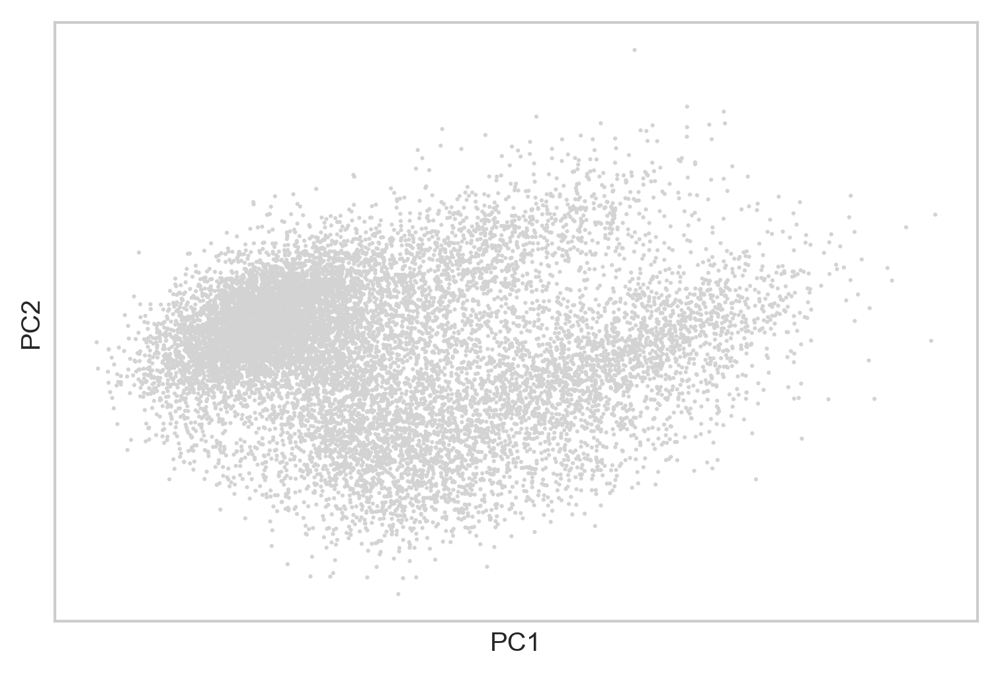

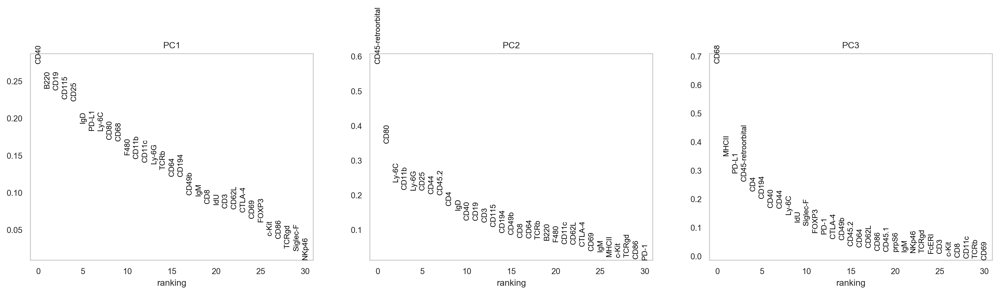

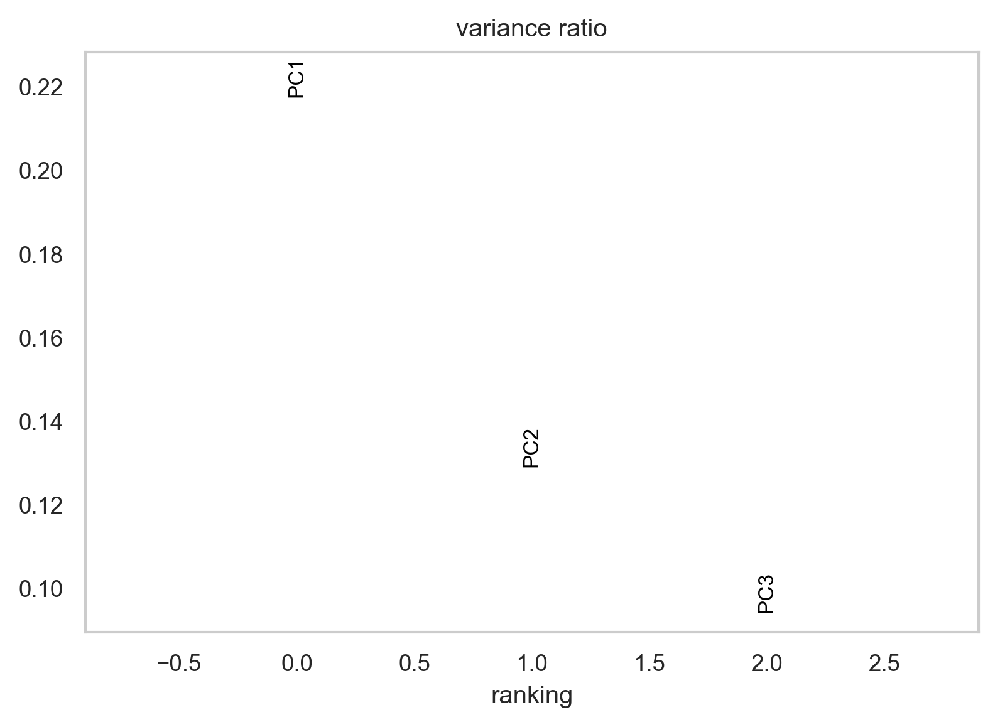

In [26]:
sc.pl.pca_overview(neu_adata_org_bl)

# Supplementary figure 4

# cluster with PDL1 and canonical neutrophil markers + IdU

In [3]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
neu_adata_path = os.path.join(subsample_path, 'Neu_bl_maternal500wo_outliers.h5ad')
neu_adata_org_bl = sc.read_h5ad(neu_adata_path)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/anndata/core/anndata.py:846: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


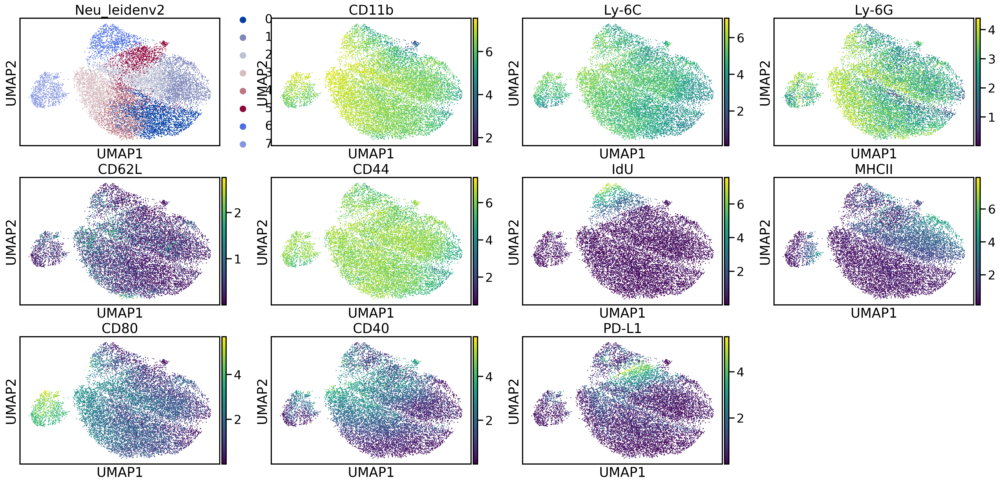

In [4]:
clustering =  ['CD11b','Ly-6C', 'Ly-6G', 'CD62L', 'CD44', 'IdU', 'MHCII', 'CD80', 'CD40', 'PD-L1']
neu_adata_org_bl.obsm['cluster_channels'] = neu_adata_org_bl[:, clustering].X
sc.pp.neighbors(neu_adata_org_bl, n_neighbors = 20, use_rep= 'cluster_channels', random_state = 1)
sc.tl.umap(neu_adata_org_bl, random_state = 1)
sc.tl.leiden(neu_adata_org_bl, resolution=0.5, key_added = 'Neu_leidenv2', random_state = 1)
sc.pl.umap(neu_adata_org_bl, color = ['Neu_leidenv2', 'CD11b','Ly-6C', 'Ly-6G', 'CD62L', 'CD44', 'IdU', 'MHCII', 'CD80', 'CD40', 'PD-L1'], use_raw = False)

In [5]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
neu_adata_path = os.path.join(subsample_path, 'Neu_bl_maternal500wo_outliers.h5ad')
neu_adata_org_bl.write(neu_adata_path)

In [6]:
umap_pd = pd.DataFrame(data = neu_adata_org_bl.obsm['X_umap'], columns = ['umap1', 'umap2']).set_index(neu_adata_org_bl.obs_names)
adata_df = pd.DataFrame(data = neu_adata_org_bl.X, columns = neu_adata_org_bl.var_names).set_index(neu_adata_org_bl.obs_names)
adata_df = pd.concat([adata_df, neu_adata_org_bl.obs, umap_pd], axis = 1, join = 'outer', copy = False)

In [7]:
adata_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,sample,cell_type,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2,Neu_leidenv2,umap1,umap2
index,,,,,,,,,,,,,,,,,,,,,
16,3.733698,3.482318,0.025405,0.000362,3.540359,2.862674,1.361506,1.185081,0.864763,0.312589,...,E12.5_3576_15,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,1,3.744891,2.421521
46,5.030386,3.235032,0.000000,0.156082,3.322356,1.621257,2.450964,0.995553,0.636060,0.502439,...,E12.5_3576_15,Neutrophils Ly6Ghi,PB-EV,10,B_cells,Neutrophils,PB-EV,1,2.942671,3.768196
190,3.762684,4.037537,0.113570,0.000362,3.977293,2.253136,2.469895,2.150812,0.965666,0.292154,...,E12.5_3576_15,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,7,-5.935161,-0.735127
240,2.139523,3.691419,0.052421,0.000362,1.301516,0.089487,0.008133,0.087274,0.224940,0.002609,...,E12.5_3576_15,Neutrophils Ly6Gmid,PB-EV,8,Neu,Neutrophils,PB-EV,2,0.529018,1.207883
68-1,3.356221,1.707314,0.100837,0.000362,3.977293,1.615526,2.796888,0.087274,0.951465,0.269706,...,E12.5_3574_1,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,1,3.583579,3.759507


In [8]:
adata_df.rename(columns = {'Neu_leidenv2': 'Neu_leiden2'}, inplace = True)

In [9]:
adata_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,sample,cell_type,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2,Neu_leiden2,umap1,umap2
index,,,,,,,,,,,,,,,,,,,,,
16,3.733698,3.482318,0.025405,0.000362,3.540359,2.862674,1.361506,1.185081,0.864763,0.312589,...,E12.5_3576_15,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,1,3.744891,2.421521
46,5.030386,3.235032,0.000000,0.156082,3.322356,1.621257,2.450964,0.995553,0.636060,0.502439,...,E12.5_3576_15,Neutrophils Ly6Ghi,PB-EV,10,B_cells,Neutrophils,PB-EV,1,2.942671,3.768196
190,3.762684,4.037537,0.113570,0.000362,3.977293,2.253136,2.469895,2.150812,0.965666,0.292154,...,E12.5_3576_15,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,7,-5.935161,-0.735127
240,2.139523,3.691419,0.052421,0.000362,1.301516,0.089487,0.008133,0.087274,0.224940,0.002609,...,E12.5_3576_15,Neutrophils Ly6Gmid,PB-EV,8,Neu,Neutrophils,PB-EV,2,0.529018,1.207883
68-1,3.356221,1.707314,0.100837,0.000362,3.977293,1.615526,2.796888,0.087274,0.951465,0.269706,...,E12.5_3574_1,Neutrophils Ly6Ghi,PB-EV,2,Neu,Neutrophils,PB-EV,1,3.583579,3.759507


In [10]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20201015_Neu_bl_maternal500wo_outliers.csv')
adata_df.to_csv(umap_path, index = False)

In [3]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20201015_Neu_bl_maternal500wo_outliers.csv')
adata_df= pd.read_csv(umap_path)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (42) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [4]:
adata_df['Neu_leiden2'] = adata_df['Neu_leiden2'].astype('str')

In [5]:
Neu_name_dict = {'3': 'act_conventional',
'1': 'presenting',
'0': 'Ly6Glow',                                       
'4': 'conventional',
'2': 'act_presenting',
'6': 'proliferating',
'7': 'CD80pos',
'5': 'immunosupressive'}

In [6]:
adata_df.loc[:,'neu_type'] = adata_df['Neu_leiden2'].map(Neu_name_dict)

In [7]:
adata_df.loc[:,'neu_type'].unique()

array(['presenting', 'CD80pos', 'act_presenting', 'immunosupressive',
       'act_conventional', 'conventional', 'proliferating', 'Ly6Glow'],
      dtype=object)

In [8]:
adata_df.to_csv(umap_path, index = False)

In [10]:
neu_clean_df = adata_df[(adata_df['test_status'] == 'test') & adata_df['organ'].isin(['PB', 'PL_F', 'PL_M'])]

In [11]:
#CD11b_mask = (neu_clean_df['CD11b']>= 6.82) & (neu_clean_df['Neu_leiden2'] == '2')
#neu_clean_df['Neu_leiden2'][CD11b_mask] = '2_CD11b'

In [12]:
neu_clean_df['neu_type'].unique()

array(['presenting', 'CD80pos', 'act_presenting', 'immunosupressive',
       'act_conventional', 'conventional', 'proliferating', 'Ly6Glow'],
      dtype=object)

In [13]:
Neu_leiden2_dict = {'act_conventional': '#F8B195',
'presenting': '#FC9134',
'Ly6Glow': '#C06C84',                                       
'conventional':'#A8E6CE',
'act_presenting':'#6C5B7B',
'proliferating': '#FE4365',
'CD80pos': '#A8A7A7',
'immunosupressive': '#2F9599'}

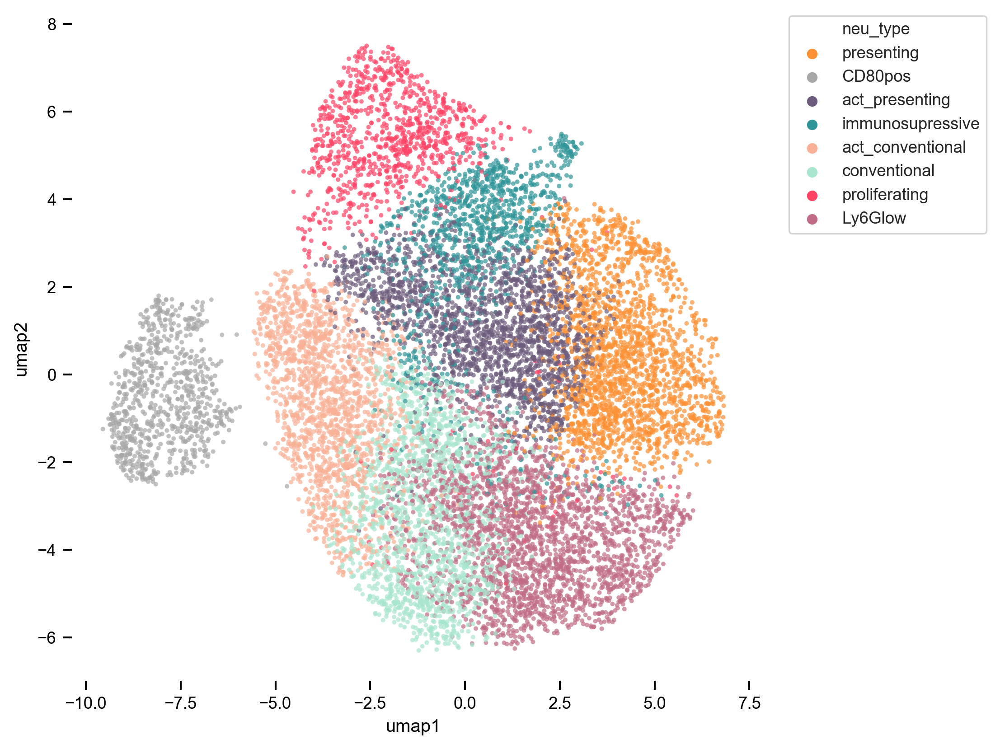

In [14]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.scatterplot(x='umap1', y='umap2', 
                data = neu_clean_df, 
                hue = 'neu_type',
                palette = Neu_leiden2_dict, 
                marker='.', linewidth = 0, alpha = 0.7)
sns.set_style("whitegrid", {'axes.grid' : False})
sns.despine(f, left=True, bottom=True)
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

In [49]:
clustering = ['CD11b','Ly-6C', 'Ly-6G', 'CD62L', 'CD44', 'IdU', 'MHCII', 'CD80', 'CD40', 'PD-L1']

In [50]:
neu_clean_df.columns

Index(['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD194', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86',
       'prpS6', 'day', 'organ', 'id', 'cage', 'timePI', 'challenge', 'origin',
       'location', 'leiden1', 'PD-L1_status', 'PD-1_status', 'CTLA-4_status',
       'CD64_status', 'CD62L_status', 'CD25_status', 'CD194_status',
       'CD69_status', 'CD80_status', 'CD86_status', 'B220_status',
       'CD40_status', 'CD44_status', 'IdU_status', 'cell_descript',
       'test_status', 'sample', 'cell_type', 'compartment', 'leiden0',
       'gen_cell_type', 'cell_type_v2', 'compartment2', 'Neu_leiden2', 'umap1',
       'umap2'],
      dtype='object')

In [51]:
neu_clean_df[clustering] = neu_clean_df[clustering].apply(lambda x:(x-x.min()) / (x.max()-x.min()))
neu_melt= neu_clean_df.melt(id_vars=['compartment2','Neu_leiden2', 'cage','id', 'day', 'umap1', 'umap2'], value_vars = clustering)
neu_melt.rename(columns = {'variable': 'marker', 'value': 'median'}, inplace = True)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:3391: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[k1] = value[k2]


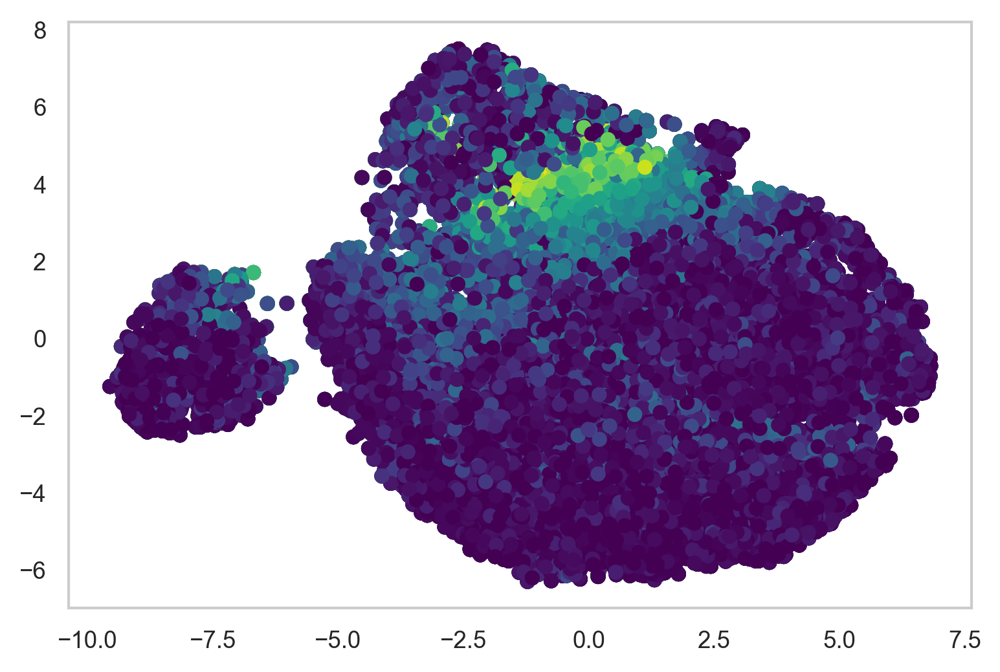

In [19]:
points = plt.scatter(neu_melt['umap1'], neu_melt['umap2'], c = neu_melt['median'], cmap='viridis')

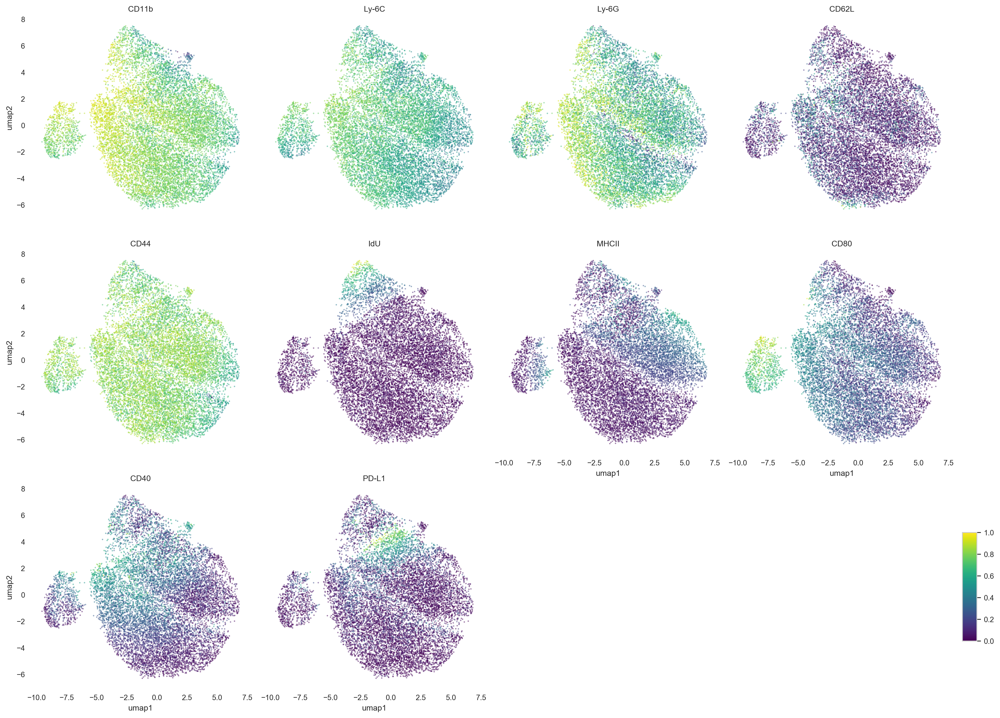

In [20]:
sns.set_context('paper', font_scale= 1)
g = sns.relplot(x='umap1', y= 'umap2', hue = 'median', col= 'marker', data= neu_melt,
                height=4, aspect=1, kind="scatter", palette = 'viridis', col_wrap=4,
                marker='.', size = 0.1, linewidth = 0, alpha = 0.5, legend = False).set_titles('{col_name}')
cax = g.fig.add_axes([1, .11, 0.015, 0.15])
plt.colorbar(points, cax=cax)
sns.despine(g, left=True, bottom=True)

In [168]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
hneu_adata_path = os.path.join(subsample_path, '20201116_CD11bhighNeu_maternal500wo_outliers.csv')
hadata_df = pd.read_csv(hneu_adata_path)
mneu_adata_path = os.path.join(subsample_path, '20201116_CD11bmidNeu_maternal500wo_outliers.csv')
madata_df= pd.read_csv(mneu_adata_path)

In [169]:
hadata_bl_df = hadata_df[hadata_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T']) & 
                            (hadata_df['challenge'] == 'sal') & 
                            (hadata_df['timePI'] == '2hr')]
madata_bl_df = madata_df[madata_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T']) & 
                            (madata_df['challenge'] == 'sal') & 
                            (madata_df['timePI'] == '2hr')]

In [174]:
df1 = madata_bl_df
PB = df1[df1['compartment2'] == 'PB-EV']
EV = df1[df1['compartment2'] == 'PL-EV']
TIS = df1[df1['compartment2']=='PL-T']

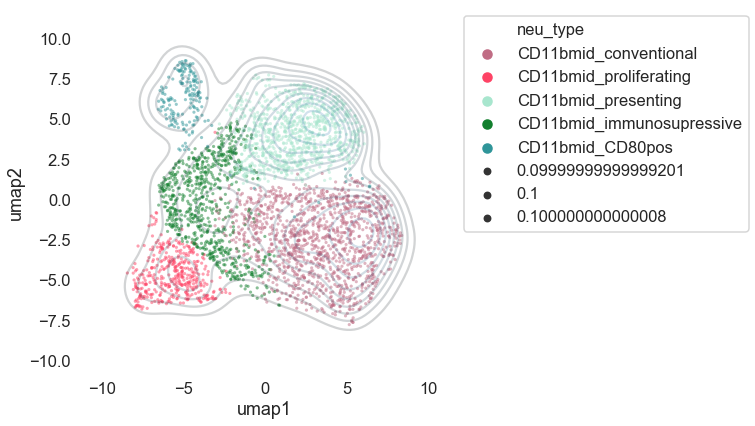

In [175]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = df1['umap1'], data2= df1['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = TIS, hue = 'neu_type', palette = Neu_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

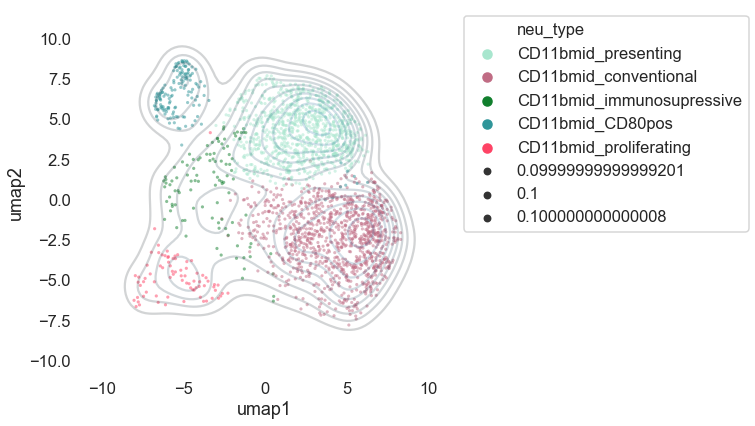

In [176]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = df1['umap1'], data2= df1['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = EV, hue = 'neu_type', palette = Neu_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

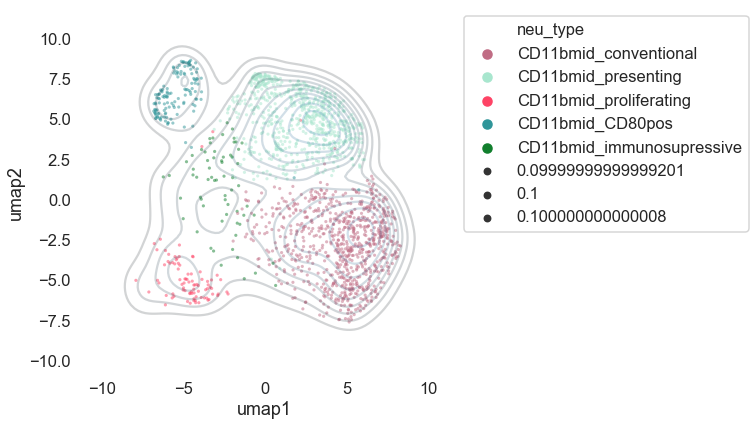

In [177]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = df1['umap1'], data2= df1['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = PB, hue = 'neu_type', palette = Neu_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Figure 4A

In [2]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20201120_Neu_bl_maternal500wo_outliers.csv')
neu_df= pd.read_csv(umap_path)
neu_df.loc[:,['cage', 'id', 'Neu_leiden2']] = neu_df.loc[:,['cage', 'id', 'Neu_leiden2']].astype(str)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (42) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [30]:
neu_df['compartment2'].unique()

array(['PB-EV', 'PL-T', 'PL-EV'], dtype=object)

In [31]:
samples_whole_PL = ['748_5_E12.5_sal_24hr_PL-T',
                    '438_4_E14.5_sal_24hr_PL-T',
                    '439_6_E14.5_sal_24hr_PL-T',
                    '2991_5_E14.5_sal_24hr_PL-T',
                    '3574_2_E12.5_lps_24hr_PL-T',
                    '3574_1_E12.5_sal_24hr_PL-T',
                    '3574_1_E12.5_sal_24hr_PL-EV',
                    '3576_15_E12.5_sal_24hr_PL-T',
                    '3576_15_E12.5_sal_24hr_PL-EV']
PL_mask = (neu_df['sample'].isin(samples_whole_PL))
neu_df['compartment2'][PL_mask] = 'PL-whole'
neu_df.to_csv(umap_path, index = False)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # This is added back by InteractiveShellApp.init_path()


subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
full_neu_adata_path = os.path.join(subsample_path, '20201116_full_Neu_maternal500wo_outliers.csv')
neu_df =pd.read_csv(full_neu_adata_path)
neu_df.loc[:, ['cage', 'id']] = neu_df.loc[:, ['cage', 'id']].astype(str)

In [3]:
neu_columns_int = ['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86', 
             'timePI',  'cage','challenge', 'day', 'id', 'neu_type2', 'compartment2', 'batch_run']



neu_clean_df = neu_df[(neu_df['batch_run'] == 2019)& 
                      (neu_df['test_status'] == 'test') & 
                      neu_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T'])]
pivot_series = neu_clean_df[neu_columns_int].pivot_table(columns= ['neu_type2', 'compartment2','challenge', 'cage','id', 'day', 'timePI'], aggfunc = 'median')
neu_median_df = pd.DataFrame(pivot_series)
neu_median_df.reset_index(inplace = True)
neu_median_df.rename(columns = {'level_0': 'marker', 0: 'median'}, inplace = True)


bl_median_df = neu_median_df[(neu_median_df['challenge'] == 'sal') & (neu_median_df['timePI'] == '2hr')]
mean_medians = bl_median_df.groupby(['marker','neu_type2']).mean()
mean_medians.reset_index(inplace = True)
heatmap_df = mean_medians.pivot_table(index = 'neu_type2', columns = 'marker', values = 'median')
int_markers = ['CD11b','Ly-6C', 'Ly-6G', 'CD62L', 'CD44', 'IdU', 'MHCII', 'CD80', 'CD40', 'PD-L1']

In [4]:
Neu_leiden2_dict = {'act_conventional': '#F8B195',
'presenting': '#FC9134',
#'Ly6Glow': '#C06C84',                                       
'conventional':'#A8E6CE',
'act_presenting':'#6C5B7B',
'proliferating': '#FE4365',
'CD80pos': '#A8A7A7',
'immunosupressive': '#2F9599'}

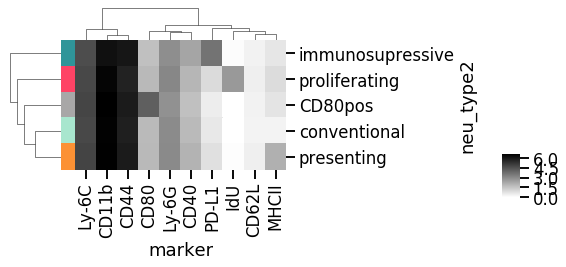

In [5]:
sns.set_context('talk', font_scale= 1)
row_colors = heatmap_df.index.map(Neu_leiden2_dict)
cg = sns.clustermap(heatmap_df.loc[:,int_markers], figsize=(5,3),
               cmap = 'binary', row_colors = row_colors,
               row_cluster = True, col_cluster = True)
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
cg.cax.set_position((1.5,0.0,.05,.2))

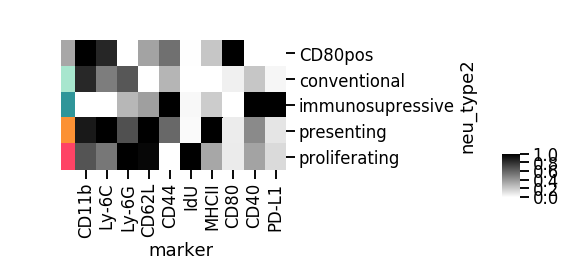

In [6]:
heatmap_ready = heatmap_df.apply(lambda x:(x-x.min()) / (x.max()-x.min()), axis = 0)
sns.set_context('talk', font_scale= 1)
row_colors = heatmap_ready.index.map(Neu_leiden2_dict)
cg = sns.clustermap(heatmap_ready.loc[:,int_markers], figsize=(5,3),
               cmap = 'binary', row_colors = row_colors,
               row_cluster = False, col_cluster = False)
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
cg.cax.set_position((1.5,0.0,.05,.2))

In [7]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20201103_Challengemaleandfemcombmaternal500wo_outliers_counts_per_sample_meta_clust.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
full_cell_counts= pd.read_csv(counts_filepath)
full_cell_counts.loc[:, ['cage', 'id']] = full_cell_counts.loc[:, ['cage', 'id']].astype(str)

In [8]:
neu_clean_df = neu_df[(neu_df['batch_run'] == 2019) & 
                      (neu_df['test_status'] == 'test') & 
                      neu_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T'])]
cell_counts = pd.DataFrame(data = neu_clean_df.groupby(['neu_type2', 'compartment2','day', 'challenge','timePI','cage', 'id']).apply(len))
cell_counts.reset_index(inplace = True)
cell_counts.rename(columns = {0: 'counts'}, inplace = True)
cell_counts['sample'] = cell_counts['cage'].astype(str).str.cat(cell_counts['id'].astype(str), sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['day'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['challenge'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['timePI'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['compartment2'], sep= '_')
sample_total = pd.DataFrame(data = cell_counts.groupby(['sample']).sum())
sample_dict = sample_total.to_dict()
cell_counts.loc[:,'sample_total'] = cell_counts['sample'].map(sample_dict['counts'])
cell_counts['frac_of_neutrophils'] = cell_counts['counts']/cell_counts['sample_total']
samp_total_df = full_cell_counts.loc[:, ['sample', 'sample_total']]
samp_total_df.set_index('sample', inplace = True)
total_counts_dict = samp_total_df.to_dict()
cell_counts.loc[:,'full_sample_total'] = cell_counts.loc[:,'sample'].map(total_counts_dict['sample_total'])
cell_counts['frac_of_immune'] = cell_counts['counts']/cell_counts['full_sample_total'] 

subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20201115_maternalNeu_edited_counts_per_sample.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
cell_counts =  pd.read_csv(counts_filepath)        
cell_counts.loc[:, ['cage', 'id']] = cell_counts.loc[:, ['cage', 'id']].astype(str)

In [9]:
clean_cell_counts = cell_counts[(cell_counts['challenge'] == 'sal') & (cell_counts['timePI'] == '2hr')]
composite = clean_cell_counts.groupby(['neu_type2', 'day','compartment2']).agg(['mean', 'sem'])
mean_sem_comp = composite.reorder_levels([1, 0], axis = 1)

In [10]:
composite_frac_all = pd.DataFrame(data = mean_sem_comp['mean']['frac_of_neutrophils'])
composite_frac_all.reset_index(inplace = True)
heatmap_all = composite_frac_all.pivot_table(index = ['neu_type2'], columns = 'compartment2', values = 'frac_of_neutrophils')
heatmap_all= heatmap_all.fillna(0)

In [11]:
heatmap_all=heatmap_all.loc[:,['PL-T', 'PL-EV', 'PB-EV']]

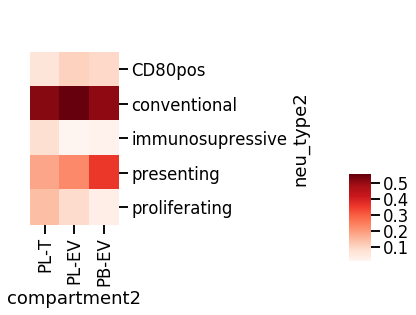

In [12]:
cg = sns.clustermap(heatmap_all, figsize=(2, 4),
               cmap = 'Reds',  
               row_cluster = False, col_cluster = False)
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
cg.cax.set_position((2.5,0.0,.15,.3))

# Figure 4B

In [13]:
bl_median_df.head(5)

,marker,neu_type2,compartment2,challenge,cage,id,day,timePI,median
20,CD45-retroorbital,CD80pos,PB-EV,sal,1136,1,E14.5,2hr,4.186368
21,CD45-retroorbital,CD80pos,PB-EV,sal,2849,11,E12.5,2hr,3.998913
22,CD45-retroorbital,CD80pos,PB-EV,sal,6943,15,E10.5,2hr,4.534390
23,CD45-retroorbital,CD80pos,PB-EV,sal,8238,1,E12.5,2hr,3.989296
24,CD45-retroorbital,CD80pos,PB-EV,sal,8238,4,E12.5,2hr,3.608064


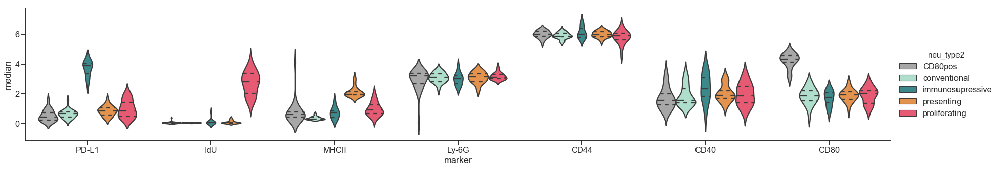

In [14]:
sns.set_style("ticks")
sns.catplot(x = 'marker', y = 'median', kind = 'violin',inner = 'quart',
            hue = 'neu_type2', palette = Neu_leiden2_dict, order = ['PD-L1', 'IdU', 'MHCII','Ly-6G', 'CD44', 'CD40', 'CD80'],
            scale='count', ci = 68, data = bl_median_df[bl_median_df['marker'].isin(['PD-L1', 'IdU', 'MHCII','Ly-6G', 'CD44', 'CD40', 'CD80'])],
            legend_out = True, aspect = 5, height = 5)

In [16]:
from scipy.stats import ttest_ind

In [17]:
t_test_data = pd.DataFrame(columns =['cluster1', 'cluster2', 'marker','t-stat', 'p-value', 'Stat diff'])

In [18]:
leiden_combos = [('2', '5'), ('2', '6'), ('5', '6')]

In [19]:
for leiden_comb in leiden_combos:
    for marker in ['PD-L1', 'IdU', 'MHCII','Ly-6G', 'CD44']:
    
            marker_leiden1 = median_df[(median_df['marker']== marker) & 
                                    (median_df['Neu_leiden2']== leiden_comb[0])]
            marker_leiden2 = median_df[(median_df['marker']== marker) & 
                                    (median_df['Neu_leiden2']== leiden_comb[1])]

            t_stat, p = ttest_ind(marker_leiden1['median'], marker_leiden2['median'])
            alpha = 0.05
            if p > alpha:
                dist = 'no'
            else:
                dist = 'yes'
            data_df = pd.DataFrame(data ={'cluster1': [leiden_comb[0]],
                                          'cluster2': [leiden_comb[1]],
                                          'marker': [marker], 
                                          't-stat': [t_stat], 
                                          'p-value': [p], 
                                          'Stat diff':[ dist]})
            t_test_data = t_test_data.append(data_df)

In [20]:
t_test_data

,cluster1,cluster2,marker,t-stat,p-value,Stat diff
0,2,5,PD-L1,-23.656019,3.997340e-62,yes
0,2,5,IdU,-3.346978,9.621560e-04,yes
0,2,5,MHCII,16.525054,2.597141e-40,yes
0,2,5,Ly-6G,6.725254,1.517042e-10,yes
0,2,5,CD44,6.544104,4.213558e-10,yes
0,2,6,PD-L1,-3.804056,1.846641e-04,yes
0,2,6,IdU,-26.269007,1.268128e-69,yes
0,2,6,MHCII,10.659402,1.217959e-21,yes
0,2,6,Ly-6G,2.381197,1.811286e-02,yes
0,2,6,CD44,8.736065,6.329001e-16,yes


# Figure 4C

In [15]:
neu_clean_df = neu_df[(neu_df['batch_run'] == 2019) & 
                      (neu_df['test_status'] == 'test') &
                      (neu_df['challenge'] == 'sal') &
                      (neu_df['timePI'] == '2hr') &
                      neu_df['compartment2'].isin(['PB-EV', 'PL-EV', 'PL-T'])]

In [16]:
PB = neu_clean_df[neu_clean_df['compartment2'] == 'PB-EV']
EV = neu_clean_df[neu_clean_df['compartment2'] == 'PL-EV']
TIS = neu_clean_df[neu_clean_df['compartment2']=='PL-T']

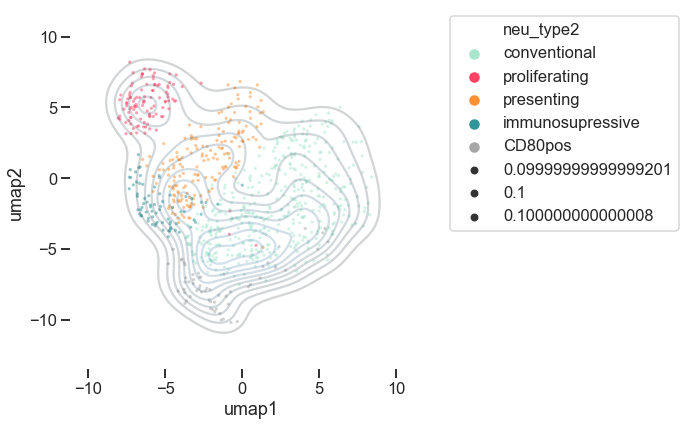

In [17]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data =  neu_clean_df['umap1'], data2=  neu_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = TIS, hue = 'neu_type2', palette = Neu_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

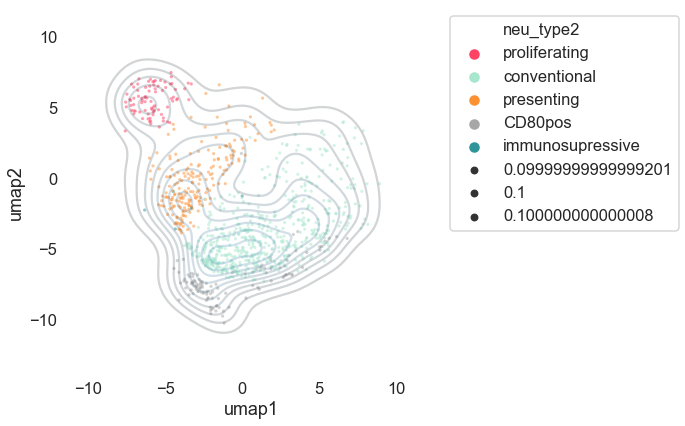

In [18]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data =  neu_clean_df['umap1'], data2=  neu_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = EV, hue = 'neu_type2', palette = Neu_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

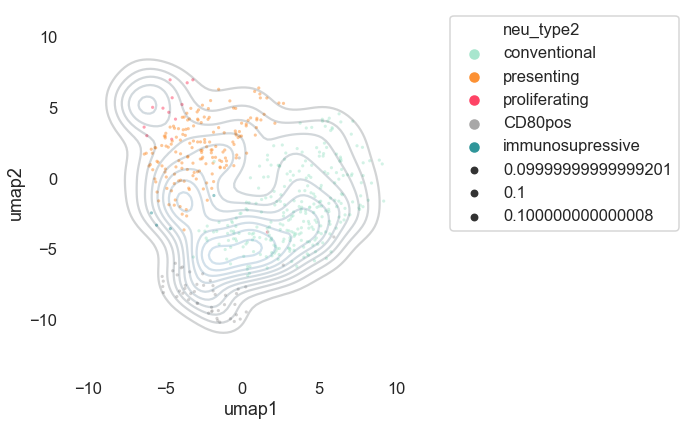

In [19]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data =  neu_clean_df['umap1'], data2=  neu_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = PB, hue = 'neu_type2', palette = Neu_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Figure 4D supplementary

In [74]:
bl_median_df.head(5)

,marker,neu_type,compartment2,challenge,cage,id,day,timePI,median
3,CD45-retroorbital,CD80pos,PB-EV,sal,428,13,E18.5,2hr,4.500065
4,CD45-retroorbital,CD80pos,PB-EV,sal,428,14,E12.5,2hr,4.260044
5,CD45-retroorbital,CD80pos,PB-EV,sal,429,16,E18.5,2hr,3.947168
6,CD45-retroorbital,CD80pos,PB-EV,sal,429,19,E11.5,2hr,3.438465
7,CD45-retroorbital,CD80pos,PB-EV,sal,429,20,E18.5,2hr,4.286056


In [115]:
bl_median_df['neu_type2'].unique()

array(['CD80pos', 'conventional', 'immunosupressive', 'presenting',
       'proliferating'], dtype=object)

In [22]:
comp_dict = {'PB-EV':'firebrick', 'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod'}

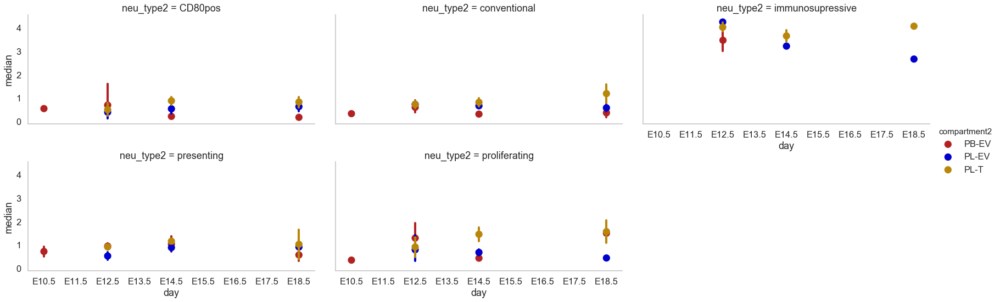

In [23]:
sns.catplot(x='day', y='median', 
                hue='compartment2', 
                height=4, aspect=2, 
                sharey= True, 
                order = ['E10.5', 'E11.5', 'E12.5', 'E13.5', 'E14.5', 'E15.5', 'E16.5', 'E17.5', 'E18.5'],
                data = bl_median_df[bl_median_df['marker'].isin(['PD-L1'])], 
                col = 'neu_type2', kind='point', palette = comp_dict, col_wrap = 3) 

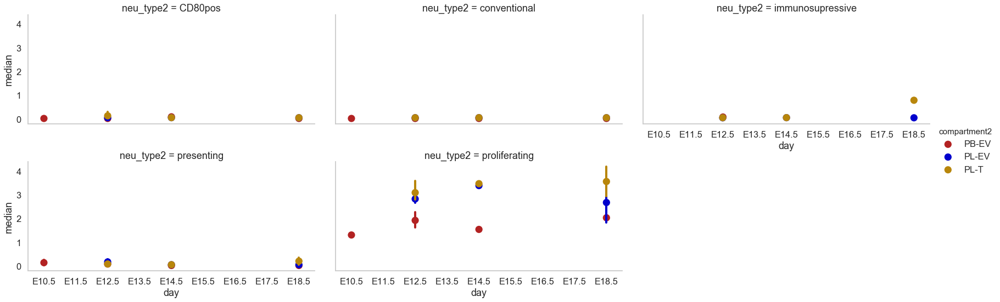

In [24]:
sns.catplot(x='day', y='median', 
                hue='compartment2', 
                height=4, aspect=2, 
                sharey= True, 
                order = ['E10.5', 'E11.5', 'E12.5', 'E13.5', 'E14.5', 'E15.5', 'E16.5', 'E17.5', 'E18.5'],
                data = bl_median_df[bl_median_df['marker'].isin(['IdU'])], 
                col = 'neu_type2', kind='point', palette = comp_dict, col_wrap = 3) 

# Figure 4D

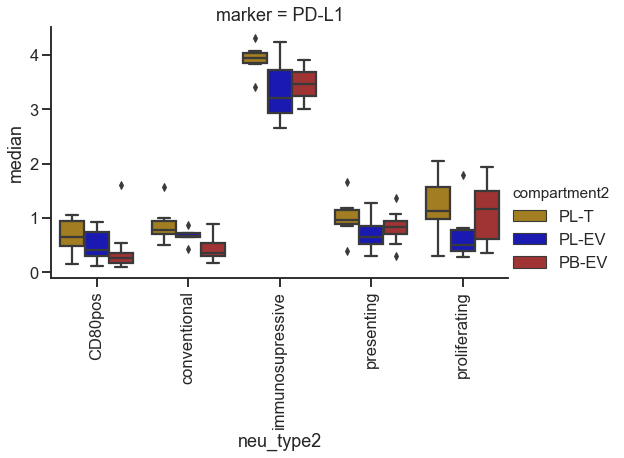

In [25]:
sns.set_style("ticks")
g = sns.catplot(x = 'neu_type2', y = 'median', kind = 'box', hue_order = ['PL-T', 'PL-EV', 'PB-EV'], sharey = False, col = 'marker',
            hue = 'compartment2', palette = {'PB-EV':'firebrick', 'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod'}, 
            ci = 68, 
            data=bl_median_df[bl_median_df['marker'].isin(['PD-L1'])],
            legend_out = True, aspect = 1.5, height = 5)
[plt.setp(ax.get_xticklabels(), rotation=90) for ax in g.axes.flat];

In [7]:
from scipy.stats import ttest_ind

In [8]:
bl_median_df.head(5)

,marker,neu_type,compartment2,challenge,cage,id,day,timePI,median
16,CD45-retroorbital,CD11bhi_CD80pos,PB-EV,sal,1136,1,E14.5,2hr,4.399824
17,CD45-retroorbital,CD11bhi_CD80pos,PB-EV,sal,2849,11,E12.5,2hr,4.137423
19,CD45-retroorbital,CD11bhi_CD80pos,PB-EV,sal,428,13,E18.5,2hr,4.635483
20,CD45-retroorbital,CD11bhi_CD80pos,PB-EV,sal,428,14,E12.5,2hr,5.494011
21,CD45-retroorbital,CD11bhi_CD80pos,PB-EV,sal,429,16,E18.5,2hr,3.888793


In [12]:
combos = [('PL-T', 'PL-EV'), ('PL-T', 'PB-EV'),('PL-EV', 'PB-EV')]

In [11]:
marker = 'PD-L1'
clusters = ['CD11bmid_immunosupressive', 'CD11bhi_immunosupressive']

In [15]:
marker = 'IdU'
clusters =['CD11bmid_proliferating', 'CD11bhi_proliferating']

In [18]:
marker = 'MHCII'
clusters =['CD11bmid_presenting', 'CD11bhi_presenting']

In [19]:
marker_medians = bl_median_df[bl_median_df['marker'] == marker]
t_test_marker = pd.DataFrame(columns =['comp1', 'comp2', 'cluster','t-stat', 'p-value', 'Stat diff'])
for comb in combos:
    for cluster in clusters:
    
            comp1 = marker_medians[(marker_medians['neu_type']== cluster) & 
                                    (marker_medians['compartment2']== comb[0])]
            comp2 = marker_medians[(marker_medians['neu_type']== cluster) & 
                                    (marker_medians['compartment2']== comb[1])]

            t_stat, p = ttest_ind(comp1['median'], comp2['median'])
            alpha = 0.05
            if p > alpha:
                dist = 'no'
            else:
                dist = 'yes'
            data_df = pd.DataFrame(data ={'comp1': [comb[0]],
                                          'comp2': [comb[1]],
                                          'cluster': [cluster], 
                                          't-stat': [t_stat], 
                                          'p-value': [p], 
                                          'Stat diff':[ dist]})
            t_test_marker = t_test_marker.append(data_df)

In [20]:
t_test_marker 

,comp1,comp2,cluster,t-stat,p-value,Stat diff
0,PL-T,PL-EV,CD11bmid_presenting,-2.034103,0.046296,yes
0,PL-T,PL-EV,CD11bhi_presenting,0.366585,0.715263,no
0,PL-T,PB-EV,CD11bmid_presenting,-3.073707,0.003073,yes
0,PL-T,PB-EV,CD11bhi_presenting,-2.531270,0.013915,yes
0,PL-EV,PB-EV,CD11bmid_presenting,-0.262378,0.793886,no
0,PL-EV,PB-EV,CD11bhi_presenting,-3.189158,0.002302,yes


# Figure 4E

In [89]:
clean_cell_counts.head(5)

,neu_type,compartment2,day,challenge,timePI,cage,id,counts,sample,sample_total,frac_of_neutrophils,full_sample_total,frac_of_immune
0,CD80pos,PB-EV,E10.5,sal,2hr,6942,8,8,6942_8_E10.5_sal_2hr_PB-EV,74,0.108108,494,0.016194
1,CD80pos,PB-EV,E10.5,sal,2hr,6944,16,11,6944_16_E10.5_sal_2hr_PB-EV,68,0.161765,496,0.022177
2,CD80pos,PB-EV,E10.5,sal,2hr,9582,15,3,9582_15_E10.5_sal_2hr_PB-EV,62,0.048387,459,0.006536
3,CD80pos,PB-EV,E11.5,sal,2hr,429,19,2,429_19_E11.5_sal_2hr_PB-EV,54,0.037037,482,0.004149
4,CD80pos,PB-EV,E11.5,sal,2hr,6942,10,2,6942_10_E11.5_sal_2hr_PB-EV,51,0.039216,462,0.004329


In [26]:
int_days = ['E10.5', 'E14.5', 'E18.5']

In [27]:
plt.rcParams['figure.dpi'] = 180
sns.set_context('talk', font_scale= 1.2)

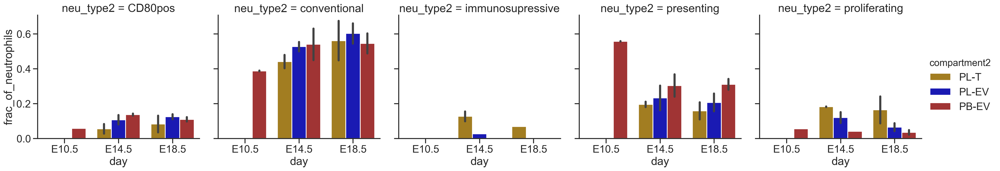

In [28]:
sns.set_style("ticks")
g = sns.catplot(x='day', y='frac_of_neutrophils',
                col='neu_type2', data= clean_cell_counts[clean_cell_counts['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

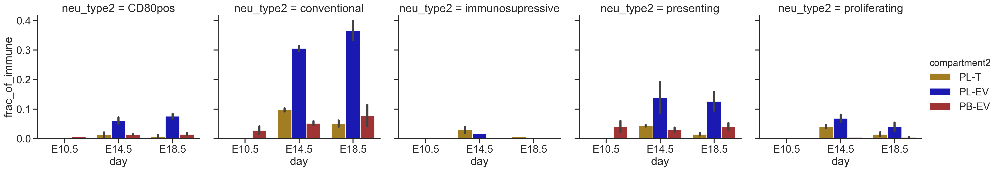

In [29]:
sns.set_style("ticks")
g = sns.catplot(x='day', y='frac_of_immune',
                col='neu_type2', data= clean_cell_counts[clean_cell_counts['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

In [118]:
days = [('E10.5', 'E14.5'), ('E14.5', 'E18.5'), ('E18.5', 'E10.5')]
combos = [('PL-T', 'PL-EV'), ('PL-EV', 'PB-EV'), ('PB-EV', 'PL-T')]
t_test_neu_frac = pd.DataFrame(columns =['cluster', 'comp_only','day1', 'day2', 't-stat_day', 'p-value_day', 'Stat diff day', 'comp1', 'comp2', 'day_only', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for cluster in ['2', '3', '5', '6']:   
    for comb in combos:
        for day in days: 
                day1 = neu_clust[(neu_clust['Neu_leiden2']== cluster) & 
                                        (neu_clust['compartment2']== comb[0])&
                                        (neu_clust['day']== day[0])]
                day2 = neu_clust[(neu_clust['Neu_leiden2']== cluster) & 
                                        (neu_clust['compartment2']== comb[0])&
                                        (neu_clust['day']== day[1])]

                t_stat_day, p_day = ttest_ind(day1['frac_of_comp_sample'], day2['frac_of_comp_sample'])
                alpha = 0.05
                if p_day > alpha:
                    dist_day = 'no'
                else:
                    dist_day = 'yes'

                comp_1 = neu_clust[(neu_clust['Neu_leiden2']== cluster) & 
                                        (neu_clust['compartment2']== comb[0])&
                                        (neu_clust['day']== day[0])]
                comp_2 = neu_clust[(neu_clust['Neu_leiden2']== cluster) & 
                                        (neu_clust['compartment2']== comb[1])&
                                        (neu_clust['day']== day[0])]

                t_stat_comp, p_comp = ttest_ind(comp_1['frac_of_comp_sample'], comp_2['frac_of_comp_sample'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'cluster': [cluster],
                                              'comp_only': [comb[0]],
                                              'day1':[day[0]],
                                              'day2':[day[1]],
                                              't-stat_day': [t_stat_day], 
                                              'p-value_day': [p_day], 
                                              'Stat diff day':[ dist_day],
                                              'comp1': [comb[0]],
                                              'comp2': [comb[1]],
                                              'day_only':[day[0]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[ dist_comp]})
                t_test_neu_frac = t_test_neu_frac.append(data_df)

In [119]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
immune_cluststats_csv = '20201022_maternalneu_of_totneu_counts_stats.csv'
immune_cluststats_filepath = os.path.join(subsample_path, immune_cluststats_csv) 
t_test_neu_frac.to_csv(immune_cluststats_filepath, index = False)

In [120]:
t_test_neu_frac

,cluster,comp_only,day1,day2,t-stat_day,p-value_day,Stat diff day,comp1,comp2,day_only,t-stat_comp,p-value_comp,Stat diff comp
0,2,PL-T,E10.5,E14.5,-3.351841,0.005202,yes,PL-T,PL-EV,E10.5,-3.415540,0.007682,yes
0,2,PL-T,E14.5,E18.5,-1.431462,0.172803,no,PL-T,PL-EV,E14.5,-3.949194,0.001148,yes
0,2,PL-T,E18.5,E10.5,5.211900,0.000218,yes,PL-T,PL-EV,E18.5,0.545031,0.594309,no
0,2,PL-EV,E10.5,E14.5,-4.645877,0.000564,yes,PL-EV,PB-EV,E10.5,-0.245699,0.812101,no
0,2,PL-EV,E14.5,E18.5,2.439309,0.027615,yes,PL-EV,PB-EV,E14.5,6.052618,0.000057,yes
0,2,PL-EV,E18.5,E10.5,0.874899,0.400329,no,PL-EV,PB-EV,E18.5,0.477602,0.642282,no
0,2,PB-EV,E10.5,E14.5,0.646062,0.536327,no,PB-EV,PL-T,E10.5,1.694787,0.124357,no
0,2,PB-EV,E14.5,E18.5,-0.881966,0.403516,no,PB-EV,PL-T,E14.5,-1.313008,0.213735,no
0,2,PB-EV,E18.5,E10.5,-0.029911,0.976871,no,PB-EV,PL-T,E18.5,-1.103006,0.293571,no
0,3,PL-T,E10.5,E14.5,-1.348785,0.210361,no,PL-T,PL-EV,E10.5,NaN,NaN,yes


In [115]:
days = [('E10.5', 'E14.5'), ('E14.5', 'E18.5'), ('E18.5', 'E10.5')]
combos = [('PL-T', 'PL-EV'), ('PL-EV', 'PB-EV'), ('PB-EV', 'PL-T')]
t_test_immune_frac = pd.DataFrame(columns =['cluster', 'comp_only','day1', 'day2', 't-stat_day', 'p-value_day', 'Stat diff day', 'comp1', 'comp2', 'day_only', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for cluster in ['2', '3', '5', '6']:   
    for comb in combos:
        for day in days: 
                day1 = neu_clust[(neu_clust['Neu_leiden2']== cluster) & 
                                        (neu_clust['compartment2']== comb[0])&
                                        (neu_clust['day']== day[0])]
                day2 = neu_clust[(neu_clust['Neu_leiden2']== cluster) & 
                                        (neu_clust['compartment2']== comb[0])&
                                        (neu_clust['day']== day[1])]

                t_stat_day, p_day = ttest_ind(day1['frac_of_immune'], day2['frac_of_immune'])
                alpha = 0.05
                if p_day > alpha:
                    dist_day = 'no'
                else:
                    dist_day = 'yes'

                comp_1 = neu_clust[(neu_clust['Neu_leiden2']== cluster) & 
                                        (neu_clust['compartment2']== comb[0])&
                                        (neu_clust['day']== day[0])]
                comp_2 = neu_clust[(neu_clust['Neu_leiden2']== cluster) & 
                                        (neu_clust['compartment2']== comb[1])&
                                        (neu_clust['day']== day[0])]

                t_stat_comp, p_comp = ttest_ind(comp_1['frac_of_immune'], comp_2['frac_of_immune'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'cluster': [cluster],
                                              'comp_only': [comb[0]],
                                              'day1':[day[0]],
                                              'day2':[day[1]],
                                              't-stat_day': [t_stat_day], 
                                              'p-value_day': [p_day], 
                                              'Stat diff day':[ dist_day],
                                              'comp1': [comb[0]],
                                              'comp2': [comb[1]],
                                              'day_only':[day[0]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[ dist_comp]})
                t_test_immune_frac = t_test_immune_frac.append(data_df)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/numpy/core/fromnumeric.py:3367: RuntimeWarning: Degrees of freedom <= 0 for slice
  **kwargs)
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/numpy/core/_methods.py:132: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


In [116]:
t_test_immune_frac

,cluster,comp_only,day1,day2,t-stat_day,p-value_day,Stat diff day,comp1,comp2,day_only,t-stat_comp,p-value_comp,Stat diff comp
0,2,PL-T,E10.5,E14.5,-4.544597,0.000551,yes,PL-T,PL-EV,E10.5,2.934845,0.016626,yes
0,2,PL-T,E14.5,E18.5,-1.630728,0.123761,no,PL-T,PL-EV,E14.5,-0.114312,0.910413,no
0,2,PL-T,E18.5,E10.5,5.052484,0.000283,yes,PL-T,PL-EV,E18.5,3.703023,0.002363,yes
0,2,PL-EV,E10.5,E14.5,-4.581530,0.000631,yes,PL-EV,PB-EV,E10.5,-1.670082,0.133451,no
0,2,PL-EV,E14.5,E18.5,2.443944,0.027365,yes,PL-EV,PB-EV,E14.5,3.394391,0.005325,yes
0,2,PL-EV,E18.5,E10.5,3.527339,0.004737,yes,PL-EV,PB-EV,E18.5,1.792784,0.100518,no
0,2,PB-EV,E10.5,E14.5,-1.378315,0.205422,no,PB-EV,PL-T,E10.5,-1.040212,0.325378,no
0,2,PB-EV,E14.5,E18.5,0.035875,0.972261,no,PB-EV,PL-T,E14.5,-3.639989,0.003388,yes
0,2,PB-EV,E18.5,E10.5,1.314627,0.225070,no,PB-EV,PL-T,E18.5,-4.232133,0.001407,yes
0,3,PL-T,E10.5,E14.5,-1.359459,0.207084,no,PL-T,PL-EV,E10.5,NaN,NaN,yes


In [117]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
immune_cluststats_csv = '20201022_maternalneu_of_immune_counts_stats.csv'
immune_cluststats_filepath = os.path.join(subsample_path, immune_cluststats_csv) 
t_test_immune_frac.to_csv(immune_cluststats_filepath, index = False)

# Supp Figure 3G

In [23]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20200928_maternalmo_nopdl1clust_cell_type_counts_per_sample.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
clean_counts_full= pd.read_csv(counts_filepath)

In [56]:
clean_counts_full['PDL1_status'] = np.where(clean_counts_full['Mo_leiden2'].isin(['0', '4', '5', '7', '8']), 'pos', 'neg')
PDL1_counts_df = clean_counts_full.groupby(['PDL1_status', 'sample']).sum()
pdl1_dict = PDL1_counts_df.loc['pos', 'counts'].to_dict()
clean_counts_full.loc[:,'pdl1_counts'] = clean_counts_full.loc[:,'sample'].map(pdl1_dict)
pdl1_clust = clean_counts_full[clean_counts_full['Mo_leiden2'].isin(['0', '4', '5', '7', '8'])]
pdl1_clust['frac_of_pdl1_pos'] = pdl1_clust['counts']/clean_counts_full['pdl1_counts'] 

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [59]:
pdl1_clust['Mo_leiden2']= pdl1_clust['Mo_leiden2'].astype('str')

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [28]:
int_days = ['E10.5', 'E14.5', 'E18.5']

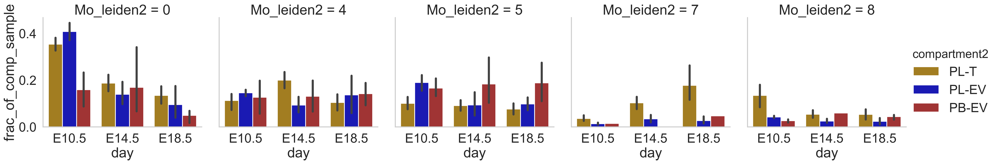

In [29]:
sns.set_context('talk', font_scale= 1.5)
g = sns.catplot(x='day', y='frac_of_comp_sample',
                col='Mo_leiden2', data= pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

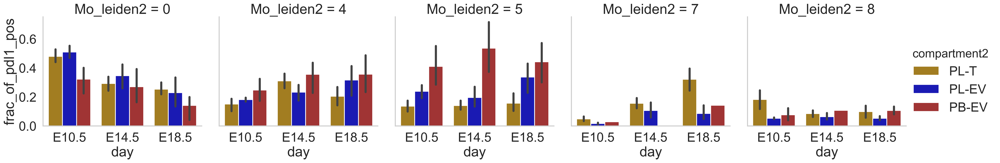

In [30]:
sns.set_context('talk', font_scale= 1.5)
g = sns.catplot(x='day', y='frac_of_pdl1_pos',
                col='Mo_leiden2', data=  pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

In [60]:
days = [('E10.5', 'E14.5'), ('E14.5', 'E18.5'), ('E18.5', 'E10.5')]
combos = [('PL-T', 'PL-EV'), ('PL-EV', 'PB-EV'), ('PB-EV', 'PL-T')]
t_test_pdl1_frac = pd.DataFrame(columns =['cluster', 'comp_only','day1', 'day2', 't-stat_day', 'p-value_day', 'Stat diff day', 'comp1', 'comp2', 'day_only', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for cluster in ['0', '4','5','7', '8']:   
    for comb in combos:
        for day in days: 
                day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                day2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[1])]

                t_stat_day, p_day = ttest_ind(day1['frac_of_pdl1_pos'], day2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_day > alpha:
                    dist_day = 'no'
                else:
                    dist_day = 'yes'

                comp_1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                comp_2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[1])&
                                        (pdl1_clust['day']== day[0])]

                t_stat_comp, p_comp = ttest_ind(comp_1['frac_of_pdl1_pos'], comp_2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'cluster': [cluster],
                                              'comp_only': [comb[0]],
                                              'day1':[day[0]],
                                              'day2':[day[1]],
                                              't-stat_day': [t_stat_day], 
                                              'p-value_day': [p_day], 
                                              'Stat diff day':[ dist_day],
                                              'comp1': [comb[0]],
                                              'comp2': [comb[1]],
                                              'day_only':[day[0]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[ dist_comp]})
                t_test_pdl1_frac = t_test_pdl1_frac.append(data_df)

In [61]:
t_test_pdl1_frac

,cluster,comp_only,day1,day2,t-stat_day,p-value_day,Stat diff day,comp1,comp2,day_only,t-stat_comp,p-value_comp,Stat diff comp
0,0,PL-T,E10.5,E14.5,4.103838,0.000507,yes,PL-T,PL-EV,E10.5,-0.875358,0.401915,no
0,0,PL-T,E14.5,E18.5,0.969763,0.342253,no,PL-T,PL-EV,E14.5,-1.113328,0.275755,no
0,0,PL-T,E18.5,E10.5,-6.510501,0.000029,yes,PL-T,PL-EV,E18.5,0.395305,0.698576,no
0,0,PL-EV,E10.5,E14.5,2.467790,0.026112,yes,PL-EV,PB-EV,E10.5,3.392448,0.007968,yes
0,0,PL-EV,E14.5,E18.5,1.621616,0.123284,no,PL-EV,PB-EV,E14.5,0.926070,0.370099,no
0,0,PL-EV,E18.5,E10.5,-4.106602,0.001455,yes,PL-EV,PB-EV,E18.5,0.891265,0.395989,no
0,0,PB-EV,E10.5,E14.5,0.603996,0.562578,no,PB-EV,PL-T,E10.5,-2.803567,0.020592,yes
0,0,PB-EV,E14.5,E18.5,1.338437,0.229239,no,PB-EV,PL-T,E14.5,-0.378149,0.709304,no
0,0,PB-EV,E18.5,E10.5,-2.236397,0.066677,no,PB-EV,PL-T,E18.5,-2.312069,0.046080,yes
0,4,PL-T,E10.5,E14.5,-3.477520,0.002376,yes,PL-T,PL-EV,E10.5,-1.193982,0.260039,no


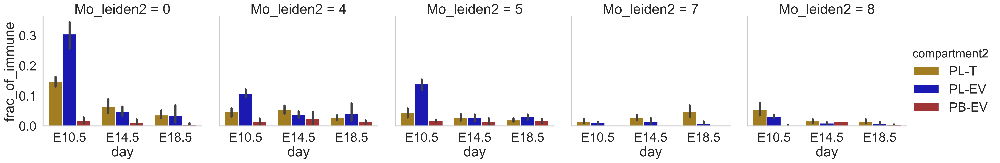

In [34]:
sns.set_context('talk', font_scale= 1.5)
g = sns.catplot(x='day', y='frac_of_immune',
                col='Mo_leiden2', data= pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

In [62]:
days = [('E10.5', 'E14.5'), ('E14.5', 'E18.5'), ('E18.5', 'E10.5')]
combos = [('PL-T', 'PL-EV'), ('PL-EV', 'PB-EV'), ('PB-EV', 'PL-T')]
t_test_immune_frac = pd.DataFrame(columns =['cluster', 'comp_only','day1', 'day2', 't-stat_day', 'p-value_day', 'Stat diff day', 'comp1', 'comp2', 'day_only', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for cluster in ['0', '4', '5','7', '8']:   
    for comb in combos:
        for day in days: 
                day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                day2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[1])]

                t_stat_day, p_day = ttest_ind(day1['frac_of_immune'], day2['frac_of_immune'])
                alpha = 0.05
                if p_day > alpha:
                    dist_day = 'no'
                else:
                    dist_day = 'yes'

                comp_1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                comp_2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[1])&
                                        (pdl1_clust['day']== day[0])]

                t_stat_comp, p_comp = ttest_ind(comp_1['frac_of_pdl1_pos'], comp_2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'cluster': [cluster],
                                              'comp_only': [comb[0]],
                                              'day1':[day[0]],
                                              'day2':[day[1]],
                                              't-stat_day': [t_stat_day], 
                                              'p-value_day': [p_day], 
                                              'Stat diff day':[ dist_day],
                                              'comp1': [comb[0]],
                                              'comp2': [comb[1]],
                                              'day_only':[day[0]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[ dist_comp]})
                t_test_immune_frac = t_test_immune_frac.append(data_df)

In [63]:
t_test_immune_frac

,cluster,comp_only,day1,day2,t-stat_day,p-value_day,Stat diff day,comp1,comp2,day_only,t-stat_comp,p-value_comp,Stat diff comp
0,0,PL-T,E10.5,E14.5,NaN,NaN,yes,PL-T,PL-EV,E10.5,-0.875358,0.401915,no
0,0,PL-T,E14.5,E18.5,NaN,NaN,yes,PL-T,PL-EV,E14.5,-1.113328,0.275755,no
0,0,PL-T,E18.5,E10.5,-10.016608,3.517673e-07,yes,PL-T,PL-EV,E18.5,0.395305,0.698576,no
0,0,PL-EV,E10.5,E14.5,NaN,NaN,yes,PL-EV,PB-EV,E10.5,3.392448,0.007968,yes
0,0,PL-EV,E14.5,E18.5,NaN,NaN,yes,PL-EV,PB-EV,E14.5,0.926070,0.370099,no
0,0,PL-EV,E18.5,E10.5,-9.345872,7.401038e-07,yes,PL-EV,PB-EV,E18.5,0.891265,0.395989,no
0,0,PB-EV,E10.5,E14.5,NaN,NaN,yes,PB-EV,PL-T,E10.5,-2.803567,0.020592,yes
0,0,PB-EV,E14.5,E18.5,NaN,NaN,yes,PB-EV,PL-T,E14.5,-0.378149,0.709304,no
0,0,PB-EV,E18.5,E10.5,-1.668952,1.461684e-01,no,PB-EV,PL-T,E18.5,-2.312069,0.046080,yes
0,4,PL-T,E10.5,E14.5,NaN,NaN,yes,PL-T,PL-EV,E10.5,-1.193982,0.260039,no
